# Prediction Tmeperature by City

*MODEL TESTING WHICH MODEL PERFROMS THE BEST FOR PREDICTIONS*

   AverageTemperature  AverageTemperatureUncertainty   City  Country  Month  \
0               6.068                          1.737  Århus  Denmark     11   
1               5.788                          3.624  Århus  Denmark      4   
2              10.644                          1.283  Århus  Denmark      5   
3              14.051                          1.347  Århus  Denmark      6   
4              16.082                          1.396  Århus  Denmark      7   

   Day  Weekday  Year  
0    1        4  1743  
1    1        2  1744  
2    1        4  1744  
3    1        0  1744  
4    1        2  1744  
Mean Squared Error: 102.94502781684314


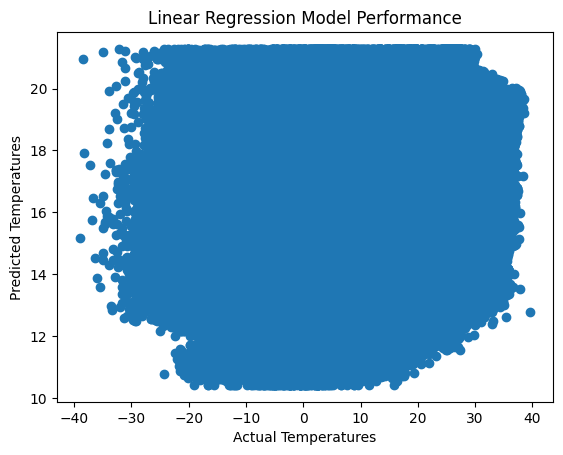

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
import seaborn as sns

# Load the cleaned dataset
df = pd.read_csv('Cleaned_GlobalLandTemperaturesByCity.csv')

# Check the first few rows of the dataset
print(df.head())

# Select features and target variable
features = ['Month', 'Day', 'Weekday', 'Year']
target = 'AverageTemperature'

X = df[features]
y = df[target]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train the linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test set
predictions = model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, predictions)
print(f'Mean Squared Error: {mse}')

# Visualize the predictions
plt.scatter(y_test, predictions)
plt.xlabel("Actual Temperatures")
plt.ylabel("Predicted Temperatures")
plt.title("Linear Regression Model Performance")
plt.show()




*since the dataset is very huge we will prefer linear regression for duture prediction here*

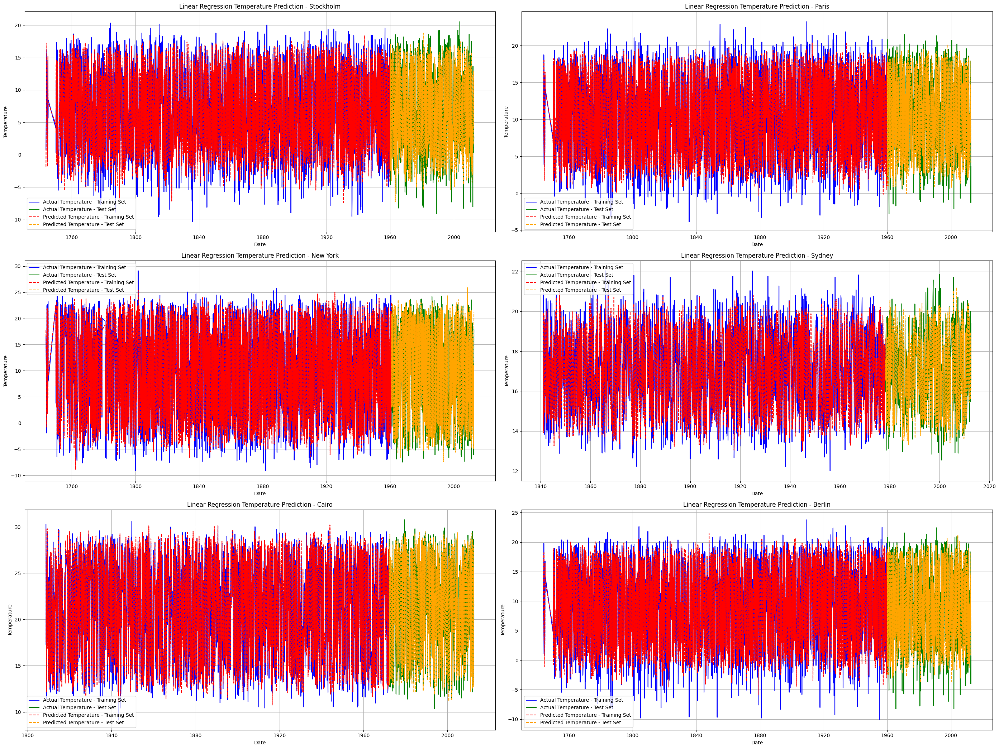

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Function to create sequences for linear regression
def create_sequences(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), 0]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

# Read the cleaned dataset
cleaned_df = pd.read_csv('Cleaned_GlobalLandTemperaturesByCity.csv')

# Create a datetime column using 'Year', 'Month', and 'Day'
cleaned_df['dt'] = pd.to_datetime(cleaned_df[['Year', 'Month', 'Day']])

# Drop the original 'Year', 'Month', and 'Day' columns if you don't need them anymore
cleaned_df = cleaned_df.drop(['Year', 'Month', 'Day'], axis=1)

# Sort the dataframe by date
cleaned_df = cleaned_df.sort_values(by='dt')

# Set 'dt' column as index
cleaned_df.set_index('dt', inplace=True)

# List of selected cities
selected_cities = ['Stockholm', 'Paris', 'New York', 'Sydney', 'Cairo', 'Berlin']

# Number of rows and columns for the subplot grid
n_rows = 3
n_cols = 2

# Create a figure for the subplots
plt.figure(figsize=(14 * n_cols, 7 * n_rows))

# Counter for the subplot index
subplot_index = 1

for city in selected_cities:
    city_df = cleaned_df[cleaned_df['City'] == city]

    # Extract the target variable
    temperature_data = city_df['AverageTemperature'].values.reshape(-1, 1)

    # Normalize the data
    scaler = MinMaxScaler(feature_range=(0, 1))
    temperature_data_scaled = scaler.fit_transform(temperature_data)

    # Create sequences with a look-back of, for example, 12 months
    look_back = 12
    X, y = create_sequences(temperature_data_scaled, look_back)

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Build the linear regression model
    model = LinearRegression()

    # Train the model
    model.fit(X_train, y_train)

    # Make predictions
    train_predict = model.predict(X_train)
    test_predict = model.predict(X_test)

    # Inverse transform the predictions to the original scale
    train_predict = scaler.inverse_transform(train_predict.reshape(-1, 1))
    y_train_original = scaler.inverse_transform([y_train])
    test_predict = scaler.inverse_transform(test_predict.reshape(-1, 1))
    y_test_original = scaler.inverse_transform([y_test])

    # Plot the results in a subplot
    plt.subplot(n_rows, n_cols, subplot_index)
    subplot_index += 1

    # Plot actual temperature in the training set
    plt.plot(city_df.index[:len(X_train)], y_train_original[0], label='Actual Temperature - Training Set', color='blue')

    # Plot actual temperature in the test set
    test_index = city_df.index[len(X_train):len(X_train) + len(X_test)]
    plt.plot(test_index, y_test_original[0], label='Actual Temperature - Test Set', color='green')

    # Plot predicted temperature in the training set
    plt.plot(city_df.index[:len(X_train)], train_predict[:, 0], label='Predicted Temperature - Training Set', linestyle='dashed', color='red')

    # Plot predicted temperature in the test set
    plt.plot(test_index, test_predict[:, 0], label='Predicted Temperature - Test Set', linestyle='dashed', color='orange')

    plt.title(f'Linear Regression Temperature Prediction - {city}')
    plt.xlabel('Date')
    plt.ylabel('Temperature')
    plt.legend()
    plt.grid(True)

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


# **Future Prediction**

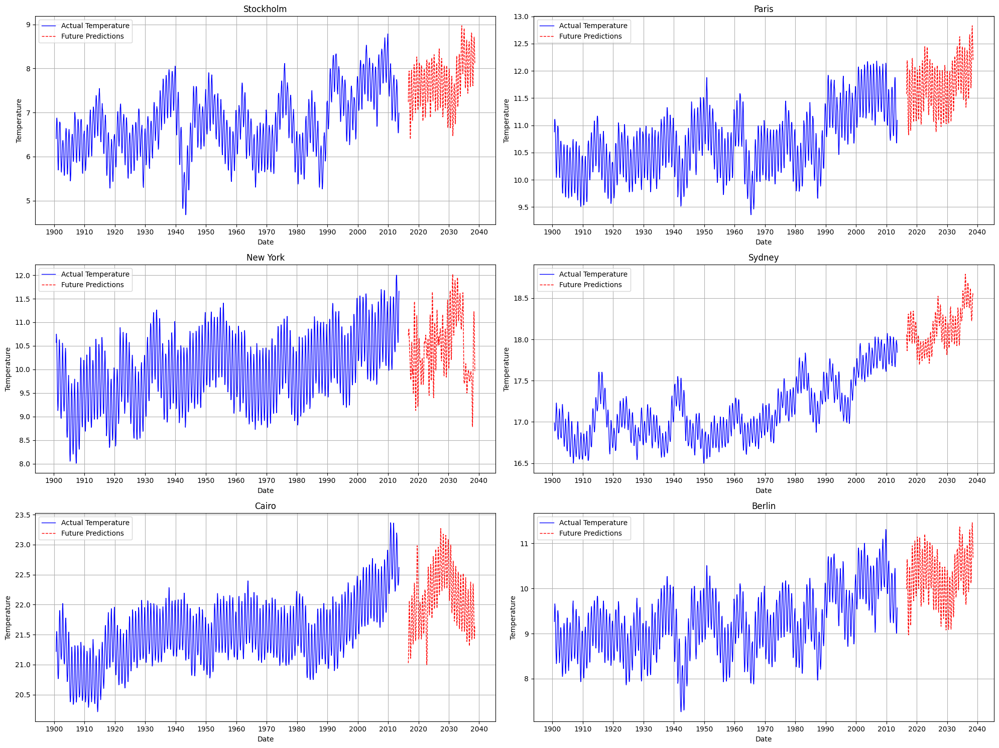

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Function to create sequences for Linear Regression
def create_sequences(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), :]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

# Read the cleaned dataset
cleaned_df = pd.read_csv('Cleaned_GlobalLandTemperaturesByCity.csv')

# Create a datetime column using 'Year', 'Month', and 'Day'
cleaned_df['dt'] = pd.to_datetime(cleaned_df[['Year', 'Month', 'Day']])

# Drop the original 'Year', 'Month', and 'Day' columns if you don't need them anymore
cleaned_df = cleaned_df.drop(['Year', 'Month', 'Day'], axis=1)

# Sort the dataframe by date
cleaned_df = cleaned_df.sort_values(by='dt')

# Set 'dt' column as index
cleaned_df.set_index('dt', inplace=True)

# List of selected cities
selected_cities = ['Stockholm', 'Paris', 'New York', 'Sydney', 'Cairo', 'Berlin']

# Set up the figure for multiple subplots
fig, axs = plt.subplots(3, 2, figsize=(20, 15))  # Adjust subplot grid as needed
axs = axs.flatten()  # Flatten the array of axes for easy indexing

# Loop through each city and each subplot
for index, city in enumerate(selected_cities):
    city_df = cleaned_df[cleaned_df['City'] == city]
    temperature_data = city_df['AverageTemperature'].values.reshape(-1, 1)
    scaler = MinMaxScaler(feature_range=(0, 1))
    temperature_data_scaled = scaler.fit_transform(temperature_data)
    look_back = 12
    X, y = create_sequences(temperature_data_scaled, look_back)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    model = LinearRegression()
    model.fit(X_train.reshape((X_train.shape[0], -1)), y_train)
    future_days = 365
    n_steps = len(X)
    lst_output = []
    for i in range(future_days):
        if i < n_steps:
            lst_output.append(temperature_data_scaled[-n_steps + i, 0])
        else:
            x_input = np.array(range(len(temperature_data), len(temperature_data) + len(lst_output)))
            x_input = x_input.reshape((1, look_back * 1))
            yhat = model.predict(x_input)
            lst_output.append(yhat[0])
    future_predictions = scaler.inverse_transform(np.array(lst_output).reshape(-1, 1))
    constant_to_add = 1.5
    future_predictions_adjusted = future_predictions + constant_to_add
    x_range_actual = 1400
    rolling_window_size = 45
    smoothed_actual = city_df['AverageTemperature'].tail(x_range_actual).rolling(window=rolling_window_size).mean().dropna()
    axs[index].plot(city_df.index[-x_range_actual:][-smoothed_actual.shape[0]:], smoothed_actual, label='Actual Temperature', color='blue', linewidth=1)
    x_range_future = 365
    future_index = pd.date_range(start=city_df.index[-1], periods=x_range_future + 1, freq='25D')[1:]
    smoothed_predictions = pd.Series(future_predictions_adjusted.ravel()).rolling(window=rolling_window_size).mean()
    axs[index].plot(future_index, smoothed_predictions, label='Future Predictions', color='red', linestyle='dashed', linewidth=1)
    axs[index].set_title(f'{city}')
    axs[index].set_xlabel('Date')
    axs[index].set_ylabel('Temperature')
    axs[index].legend()
    years_ticks = pd.date_range(start='1900-01-01', end='2040-01-01', freq='10YS')
    axs[index].set_xticks(years_ticks)
    axs[index].set_xticklabels([str(year.year) for year in years_ticks])
    axs[index].grid(True)

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


# Prediction Tmeperature by Country

*MODEL TESTING WHICH MODEL PERFROMS THE BEST FOR PREDICTIONS*

   AverageTemperature  AverageTemperatureUncertainty Country  Month  Day  \
0               4.384                          2.294   Åland     11    1   
1               1.530                          4.680   Åland      4    1   
2               6.702                          1.789   Åland      5    1   
3              11.609                          1.577   Åland      6    1   
4              15.342                          1.410   Åland      7    1   

   Weekday  Year  
0        4  1743  
1        2  1744  
2        4  1744  
3        0  1744  
4        2  1744  
Mean Squared Error: 112.59681042430515


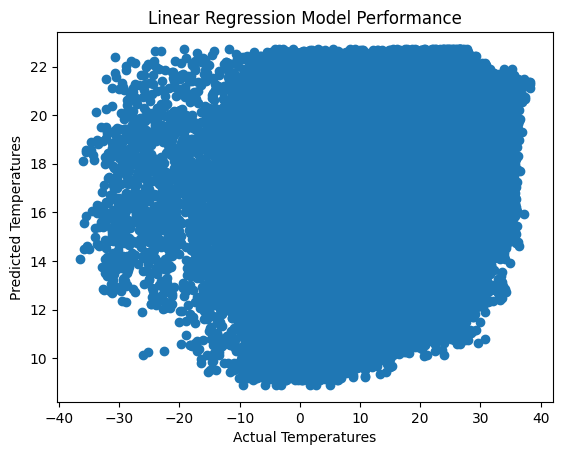

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
import seaborn as sns

# Load the cleaned dataset
df = pd.read_csv('Cleaned_GlobalLandTemperaturesByCountry.csv')

# Check the first few rows of the dataset
print(df.head())

# Select features and target variable
features = ['Month', 'Day', 'Weekday', 'Year']
target = 'AverageTemperature'

X = df[features]
y = df[target]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train the linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test set
predictions = model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, predictions)
print(f'Mean Squared Error: {mse}')

# Visualize the predictions
plt.scatter(y_test, predictions)
plt.xlabel("Actual Temperatures")
plt.ylabel("Predicted Temperatures")
plt.title("Linear Regression Model Performance")
plt.show()


c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\tsa\statespace\representation.py:374: FutureWarning: Unknown keyword arguments: dict_keys(['typ']).Passing unknown keyword arguments will raise a TypeError beginning in version 0.15.
  warnings.warn(msg, FutureWarning)


Mean Squared Error: 237.9410719409432


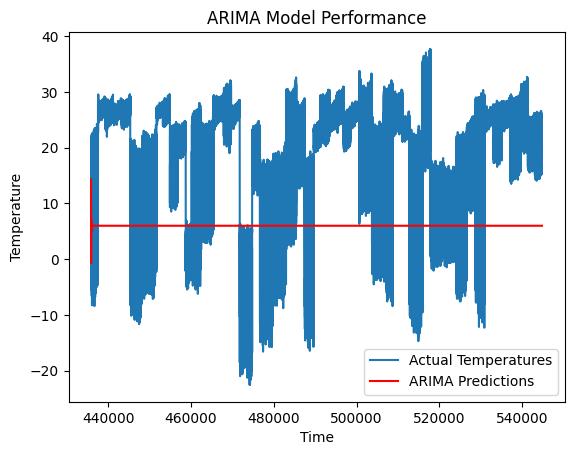

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Load the cleaned dataset
df = pd.read_csv('Cleaned_GlobalLandTemperaturesByCountry.csv')

# Select target variable
target = 'AverageTemperature'
y = df[target]

# Split the data into training and testing sets
train_size = int(len(y) * 0.8)
train, test = y[:train_size], y[train_size:]

# Initialize and train the ARIMA model
model = ARIMA(train, order=(5, 1, 0))  # You can experiment with the order parameter
fit_model = model.fit()

# Make predictions on the test set
predictions = fit_model.predict(start=len(train), end=len(train) + len(test) - 1, typ='levels')

# Evaluate the model
mse = mean_squared_error(test, predictions)
print(f'Mean Squared Error: {mse}')

# Visualize the predictions
plt.plot(test, label='Actual Temperatures')
plt.plot(predictions, color='red', label='ARIMA Predictions')
plt.xlabel("Time")
plt.ylabel("Temperature")
plt.title("ARIMA Model Performance")
plt.legend()
plt.show()


In [6]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import lightgbm as lgb

# Load the cleaned dataset
df = pd.read_csv('Cleaned_GlobalLandTemperaturesByCountry.csv')

# Features and target variable
X = df[['Month', 'Day', 'Weekday', 'Year']]
y = df['AverageTemperature']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# XGBoost
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42)
xgb_model.fit(X_train, y_train)
y_pred_xgb = xgb_model.predict(X_test)

# LightGBM
lgb_model = lgb.LGBMRegressor(random_state=42)
lgb_model.fit(X_train, y_train)
y_pred_lgb = lgb_model.predict(X_test)

# Evaluate the models
mse_xgb = mean_squared_error(y_test, y_pred_xgb)
mse_lgb = mean_squared_error(y_test, y_pred_lgb)

print(f"Mean Squared Error (XGBoost): {mse_xgb}")
print(f"Mean Squared Error (LightGBM): {mse_lgb}")


c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:359: FutureWarning: is_categorical_dtype is deprecated and will be 

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.026256 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 251
[LightGBM] [Info] Number of data points in the train set: 435848, number of used features: 3
[LightGBM] [Info] Start training from score 17.200221
Mean Squared Error (XGBoost): 96.46794643356243
Mean Squared Error (LightGBM): 96.16556378464163


In [7]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

# Load your cleaned dataset
df = pd.read_csv('Cleaned_GlobalLandTemperaturesByCountry.csv')

# Extract the temperature values
temperature_data = df['AverageTemperature'].values.reshape(-1, 1)

# Normalize the temperature values
scaler = MinMaxScaler(feature_range=(0, 1))
temperature_data_normalized = scaler.fit_transform(temperature_data)

# Prepare the data for LSTM
def create_dataset(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), 0]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

look_back = 12  # You can adjust this value based on your preference
X, y = create_dataset(temperature_data_normalized, look_back)

# Reshape input to be [samples, time steps, features]
X = np.reshape(X, (X.shape[0], 1, X.shape[1]))

# Define the LSTM model
model = Sequential()
model.add(LSTM(units=50, input_shape=(1, look_back)))
model.add(Dense(units=1))
model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model
model.fit(X, y, epochs=20, batch_size=32)

# Make predictions
train_predict = model.predict(X)
train_predict = scaler.inverse_transform(train_predict)
y_actual = scaler.inverse_transform(y.reshape(-1, 1))

# Calculate Mean Squared Error
mse = mean_squared_error(y_actual, train_predict)
print(f"Mean Squared Error (LSTM): {mse}")





Epoch 1/20

17025/17025 [==============================] - 61s 3ms/step - loss: 7.6526e-04
Epoch 2/20
17025/17025 [==============================] - 59s 3ms/step - loss: 3.6336e-04
Epoch 3/20
17025/17025 [==============================] - 62s 4ms/step - loss: 3.5845e-04
Epoch 4/20
17025/17025 [==============================] - 55s 3ms/step - loss: 3.5598e-04
Epoch 5/20
17025/17025 [==============================] - 55s 3ms/step - loss: 3.5264e-04
Epoch 6/20
17025/17025 [==============================] - 56s 3ms/step - loss: 3.4992e-04
Epoch 7/20
17025/17025 [==============================] - 55s 3ms/step - loss: 3.4768e-04
Epoch 8/20
17025/17025 [==============================] - 55s 3ms/step - loss: 3.4667e-04
Epoch 9/20
17025/17025 [==============================] - 55s 3ms/step - loss: 3.4443e-04
Epoch 10/20
17025/17025 [==============================] - 55s 3ms/step - loss: 3.4273e-04
Epoch 11/20
17025/17025 [==============================] - 56s 3ms/step - loss: 3.4079e-04
Epoc

# **LSTM PERFROMED THE BEST**




Epoch 1/50

79/79 [==============================] - 13s 51ms/step - loss: 0.0796 - val_loss: 0.0509
Epoch 2/50
79/79 [==============================] - 1s 19ms/step - loss: 0.0155 - val_loss: 0.0089
Epoch 3/50
79/79 [==============================] - 2s 19ms/step - loss: 0.0045 - val_loss: 0.0047
Epoch 4/50
79/79 [==============================] - 2s 22ms/step - loss: 0.0042 - val_loss: 0.0051
Epoch 5/50
79/79 [==============================] - 1s 19ms/step - loss: 0.0045 - val_loss: 0.0037
Epoch 6/50
79/79 [==============================] - 2s 20ms/step - loss: 0.0040 - val_loss: 0.0035
Epoch 7/50
79/79 [==============================] - 1s 18ms/step - loss: 0.0043 - val_loss: 0.0073
Epoch 8/50
79/79 [==============================] - 2s 20ms/step - loss: 0.0039 - val_loss: 0.0048
Epoch 9/50
79/79 [==============================] - 2s 21ms/step - loss: 0.0038 - val_loss: 0.0048
Epoch 10/50
79/79 [==============================] - 1s 19ms/step - loss: 0.0040 - val_loss: 0.0033
Epoc

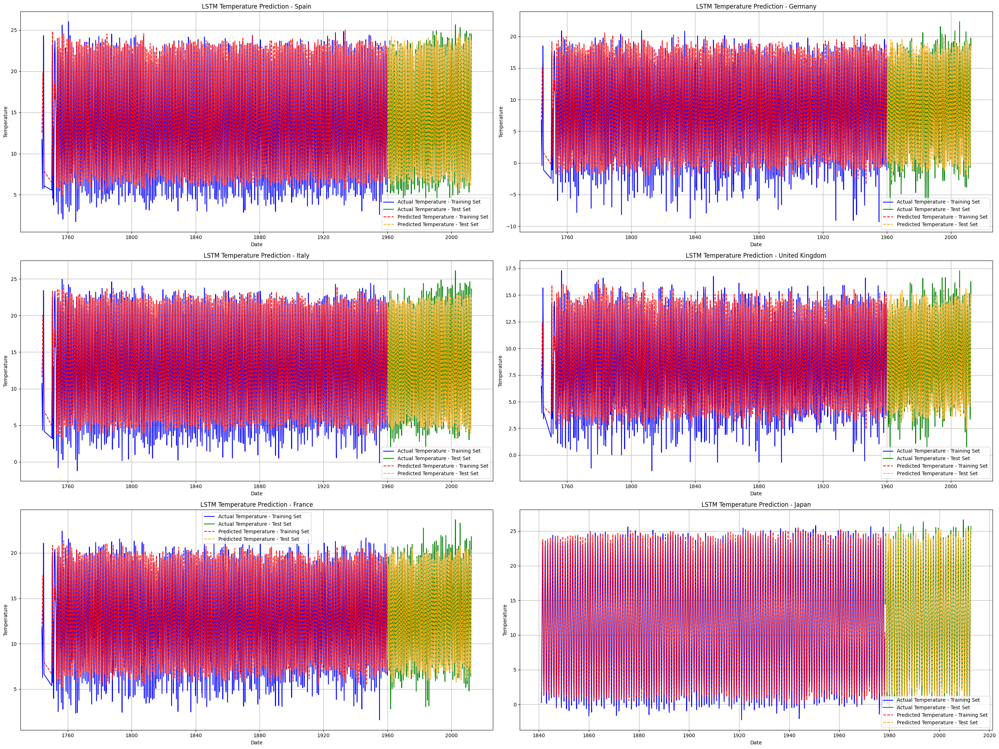

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping

# Function to create sequences for LSTM
def create_sequences(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), 0]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

# Read the cleaned dataset
cleaned_df = pd.read_csv('Cleaned_GlobalLandTemperaturesByCountry.csv')

# Create a datetime column using 'Year', 'Month', and 'Day'
cleaned_df['dt'] = pd.to_datetime(cleaned_df[['Year', 'Month', 'Day']])

# Drop the original 'Year', 'Month', and 'Day' columns if you don't need them anymore
cleaned_df = cleaned_df.drop(['Year', 'Month', 'Day'], axis=1)

# Sort the dataframe by date
cleaned_df = cleaned_df.sort_values(by='dt')

# Set 'dt' column as index
cleaned_df.set_index('dt', inplace=True)

# List of selected countries
selected_countries = ['Spain', 'Germany', 'Italy', 'United Kingdom', 'France', 'Japan']

# Number of rows and columns for the subplot grid
n_rows = 3
n_cols = 2

# Create a figure for the subplots
plt.figure(figsize=(14 * n_cols, 7 * n_rows))

# Counter for the subplot index
subplot_index = 1

for country in selected_countries:
    country_df = cleaned_df[cleaned_df['Country'] == country]

    # Extract the target variable
    temperature_data = country_df['AverageTemperature'].values.reshape(-1, 1)

    # Normalize the data
    scaler = MinMaxScaler(feature_range=(0, 1))
    temperature_data_scaled = scaler.fit_transform(temperature_data)

    # Create sequences with a look-back of, for example, 12 months
    look_back = 12
    X, y = create_sequences(temperature_data_scaled, look_back)

    # Reshape the input data for LSTM
    X = np.reshape(X, (X.shape[0], X.shape[1], 1))

    # Split the data into training and testing sets
    train_size = int(len(X) * 0.8)
    X_train, y_train = X[:train_size], y[:train_size]
    X_test, y_test = X[train_size:], y[train_size:]

    # Build the LSTM model
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
    model.add(LSTM(units=50))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Use early stopping to prevent overfitting
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

    # Train the model
    model.fit(X_train, y_train, epochs=50, batch_size=32, validation_data=(X_test, y_test), callbacks=[early_stopping])

    # Make predictions
    train_predict = model.predict(X_train)
    test_predict = model.predict(X_test)

    # Inverse transform the predictions to the original scale
    train_predict = scaler.inverse_transform(train_predict)
    y_train_original = scaler.inverse_transform([y_train])
    test_predict = scaler.inverse_transform(test_predict)
    y_test_original = scaler.inverse_transform([y_test])

    # Plot the results in a subplot
    plt.subplot(n_rows, n_cols, subplot_index)
    subplot_index += 1

    # Plot actual temperature in the training set
    plt.plot(country_df.index[:train_size], y_train_original[0], label='Actual Temperature - Training Set', color='blue')

    # Plot actual temperature in the test set
    test_index = country_df.index[train_size:train_size + len(y_test_original[0])]
    plt.plot(test_index, y_test_original[0], label='Actual Temperature - Test Set', color='green')

    # Plot predicted temperature in the training set
    plt.plot(country_df.index[:train_size], train_predict[:, 0], label='Predicted Temperature - Training Set', linestyle='dashed', color='red')

    # Plot predicted temperature in the test set
    plt.plot(test_index, test_predict[:, 0], label='Predicted Temperature - Test Set', linestyle='dashed', color='orange')

    plt.title(f'LSTM Temperature Prediction - {country}')
    plt.xlabel('Date')
    plt.ylabel('Temperature')
    plt.legend()
    plt.grid(True)

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


# **Future Prediction**

Epoch 1/50
89/89 [==============================] - 8s 35ms/step - loss: 0.0798 - val_loss: 0.0372
Epoch 2/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0113 - val_loss: 0.0040
Epoch 3/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0050 - val_loss: 0.0054
Epoch 4/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0046 - val_loss: 0.0066
Epoch 5/50
89/89 [==============================] - 1s 15ms/step - loss: 0.0044 - val_loss: 0.0040
Epoch 6/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0043 - val_loss: 0.0055
Epoch 7/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0043 - val_loss: 0.0065


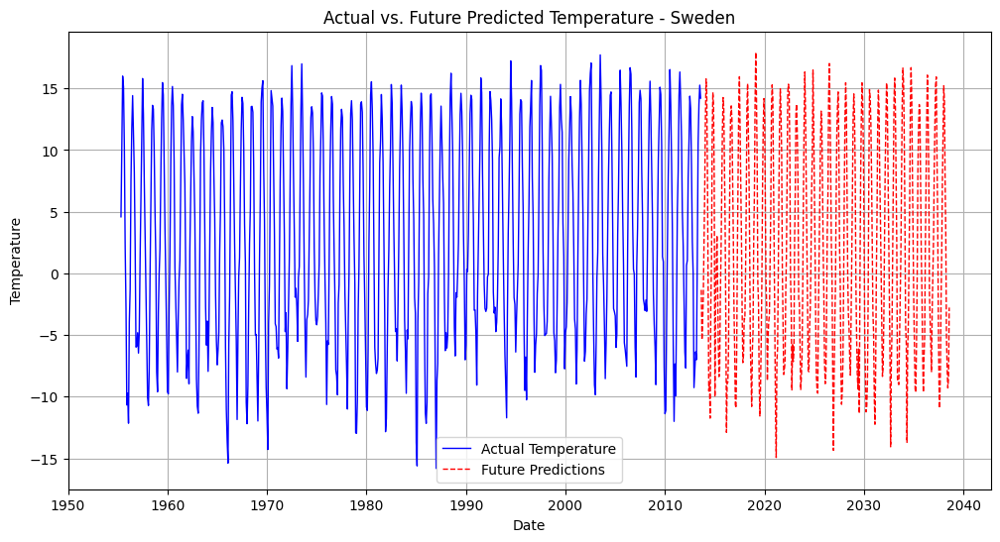

Epoch 1/50
89/89 [==============================] - 8s 34ms/step - loss: 0.0648 - val_loss: 0.0381
Epoch 2/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0166 - val_loss: 0.0136
Epoch 3/50
89/89 [==============================] - 1s 15ms/step - loss: 0.0052 - val_loss: 0.0042
Epoch 4/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0051 - val_loss: 0.0048
Epoch 5/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0050 - val_loss: 0.0073
Epoch 6/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0047 - val_loss: 0.0069
Epoch 7/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0050 - val_loss: 0.0040
Epoch 8/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0044 - val_loss: 0.0038
Epoch 9/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0045 - val_loss: 0.0036
Epoch 10/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0045 - val_loss: 0.0062
Epoch 11/

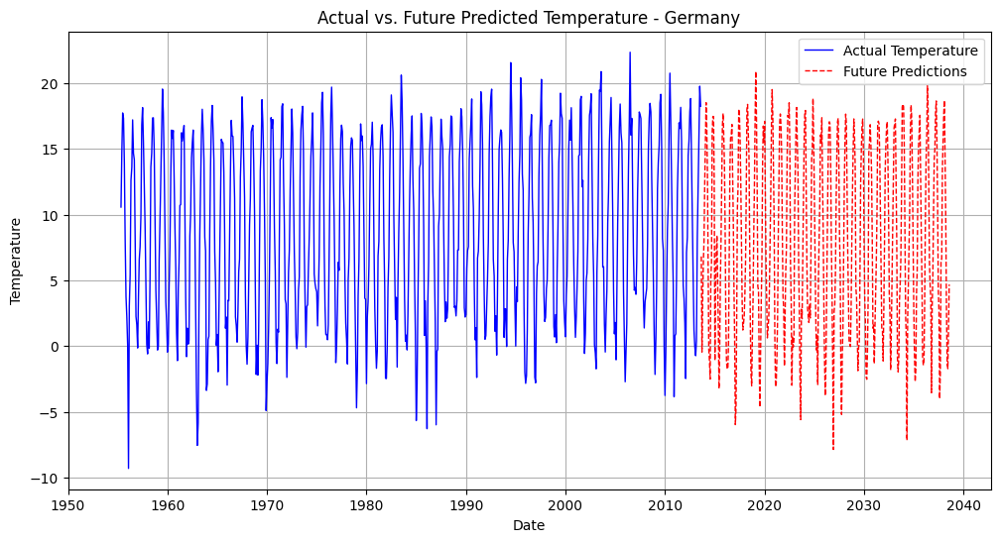

Epoch 1/50
89/89 [==============================] - 8s 28ms/step - loss: 0.0704 - val_loss: 0.0493
Epoch 2/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0123 - val_loss: 0.0062
Epoch 3/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0038 - val_loss: 0.0077
Epoch 4/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0039 - val_loss: 0.0050
Epoch 5/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0035 - val_loss: 0.0033
Epoch 6/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0037 - val_loss: 0.0031
Epoch 7/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0038 - val_loss: 0.0032
Epoch 8/50
89/89 [==============================] - 2s 17ms/step - loss: 0.0032 - val_loss: 0.0054
Epoch 9/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0035 - val_loss: 0.0026
Epoch 10/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0035 - val_loss: 0.0087
Epoch 11/

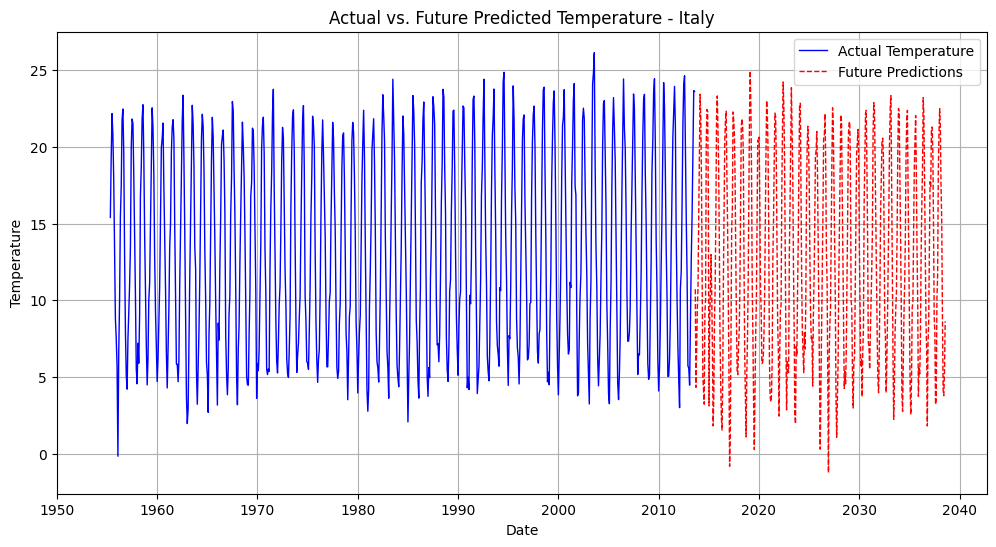

Epoch 1/50
89/89 [==============================] - 8s 36ms/step - loss: 0.0652 - val_loss: 0.0397
Epoch 2/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0232 - val_loss: 0.0089
Epoch 3/50
89/89 [==============================] - 1s 15ms/step - loss: 0.0071 - val_loss: 0.0039
Epoch 4/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0058 - val_loss: 0.0115
Epoch 5/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0055 - val_loss: 0.0082
Epoch 6/50
89/89 [==============================] - 1s 15ms/step - loss: 0.0056 - val_loss: 0.0111
Epoch 7/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0056 - val_loss: 0.0045
Epoch 8/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0053 - val_loss: 0.0088


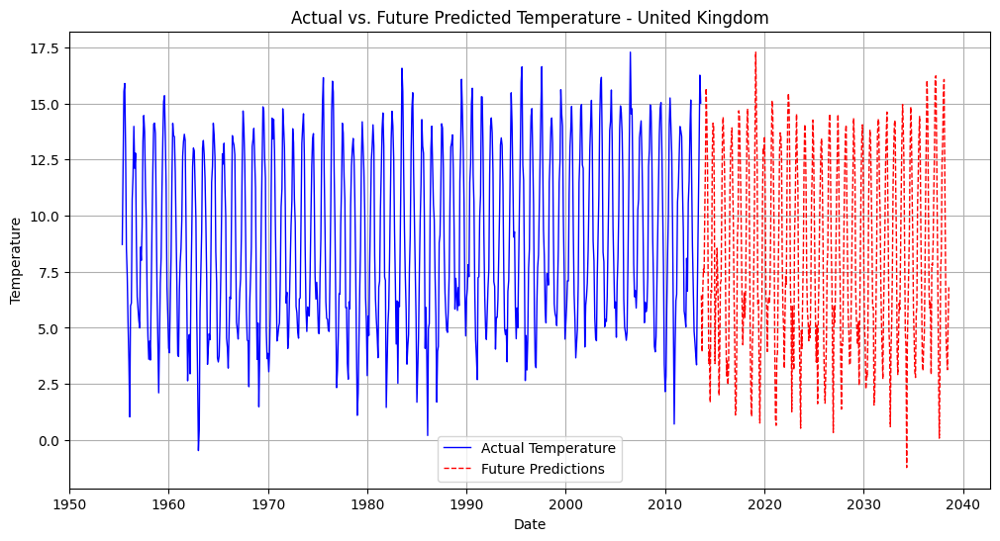

Epoch 1/50
89/89 [==============================] - 9s 33ms/step - loss: 0.0658 - val_loss: 0.0436
Epoch 2/50
89/89 [==============================] - 1s 15ms/step - loss: 0.0184 - val_loss: 0.0082
Epoch 3/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0048 - val_loss: 0.0151
Epoch 4/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0046 - val_loss: 0.0063
Epoch 5/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0051 - val_loss: 0.0098
Epoch 6/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0043 - val_loss: 0.0048
Epoch 7/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0044 - val_loss: 0.0033
Epoch 8/50
89/89 [==============================] - 2s 17ms/step - loss: 0.0044 - val_loss: 0.0037
Epoch 9/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0041 - val_loss: 0.0055
Epoch 10/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0045 - val_loss: 0.0069
Epoch 11/

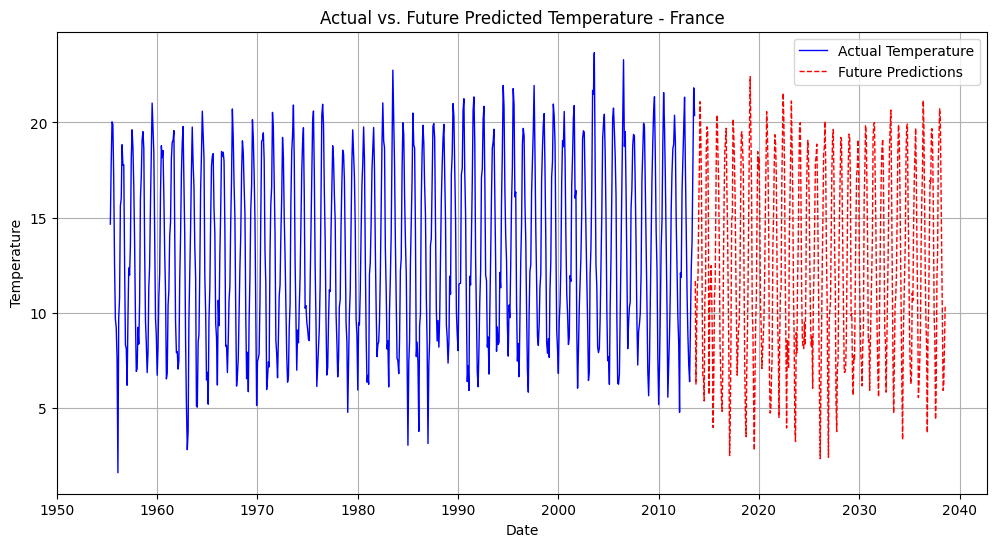

Epoch 1/50
58/58 [==============================] - 7s 36ms/step - loss: 0.0927 - val_loss: 0.0573
Epoch 2/50
58/58 [==============================] - 1s 19ms/step - loss: 0.0160 - val_loss: 0.0067
Epoch 3/50
58/58 [==============================] - 1s 15ms/step - loss: 0.0021 - val_loss: 0.0037
Epoch 4/50
58/58 [==============================] - 1s 15ms/step - loss: 0.0024 - val_loss: 0.0040
Epoch 5/50
58/58 [==============================] - 1s 15ms/step - loss: 0.0020 - val_loss: 0.0024
Epoch 6/50
58/58 [==============================] - 1s 15ms/step - loss: 0.0017 - val_loss: 0.0013
Epoch 7/50
58/58 [==============================] - 1s 19ms/step - loss: 0.0016 - val_loss: 0.0034
Epoch 8/50
58/58 [==============================] - 1s 15ms/step - loss: 0.0017 - val_loss: 0.0025
Epoch 9/50
58/58 [==============================] - 1s 15ms/step - loss: 0.0016 - val_loss: 0.0049
Epoch 10/50
58/58 [==============================] - 1s 14ms/step - loss: 0.0016 - val_loss: 0.0023
Epoch 11/

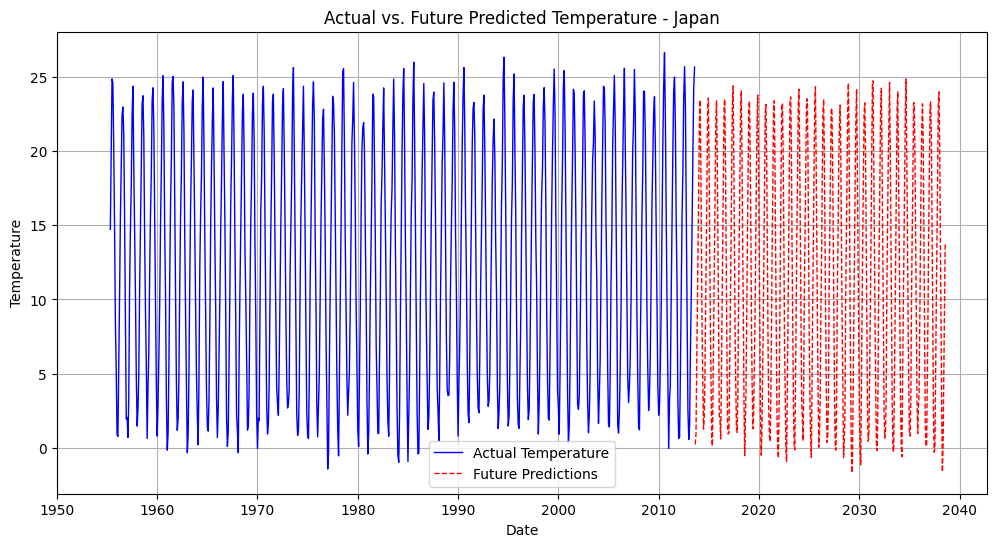

In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping

# Function to create sequences for LSTM
def create_sequences(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), :]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

# Read the cleaned dataset
cleaned_df = pd.read_csv('Cleaned_GlobalLandTemperaturesByCountry.csv')  # Replace with your actual file path

# Create a datetime column using 'Year', 'Month', and 'Day'
cleaned_df['dt'] = pd.to_datetime(cleaned_df[['Year', 'Month', 'Day']])

# Drop the original 'Year', 'Month', and 'Day' columns if you don't need them anymore
cleaned_df = cleaned_df.drop(['Year', 'Month', 'Day'], axis=1)

# Sort the dataframe by date
cleaned_df = cleaned_df.sort_values(by='dt')

# Set 'dt' column as index
cleaned_df.set_index('dt', inplace=True)

# List of selected countries
selected_countries = ['Sweden', 'Germany', 'Italy', 'United Kingdom', 'France', 'Japan']

# Separate graphs for actual data and future predictions for each selected country
for country in selected_countries:
    country_df = cleaned_df[cleaned_df['Country'] == country]

    # Extract the target variable
    temperature_data = country_df['AverageTemperature'].values.reshape(-1, 1)

    # Normalize the data
    scaler = MinMaxScaler(feature_range=(0, 1))
    temperature_data_scaled = scaler.fit_transform(temperature_data)

    # Create sequences with a look-back of, for example, 12 months
    look_back = 12
    X, y = create_sequences(temperature_data_scaled, look_back)

    # Reshape the input data for LSTM
    X = np.reshape(X, (X.shape[0], X.shape[1], X.shape[2]))

    # Build the LSTM model
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(X.shape[1], X.shape[2])))
    model.add(LSTM(units=50))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Use early stopping to prevent overfitting
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

    # Train the model
    model.fit(X, y, epochs=50, batch_size=32, validation_split=0.1, callbacks=[early_stopping])

    # Make predictions
    future_days = 365  # Adjust as needed
    n_steps = len(X)

    lst_output = []

    for i in range(future_days):
        if i < n_steps:
            # If still within the original data, use actual data
            lst_output.append(temperature_data_scaled[-n_steps + i, 0])
        else:
            # Use the model to predict future values
            x_input = np.array(range(len(temperature_data), len(temperature_data) + len(lst_output)))
            x_input = x_input.reshape((1, look_back, 1))
            yhat = model.predict(x_input, verbose=0)
            lst_output.append(yhat[0, 0])

    # Inverse transform the predictions to the original scale
    future_predictions = scaler.inverse_transform(np.array(lst_output).reshape(-1, 1))

    # Plot actual and future predictions for each country
    plt.figure(figsize=(12, 6))
    
    # Adjust the x-axis range for actual data to display the last 1 year
    x_range_actual = 700  
    plt.plot(country_df.index[-x_range_actual:], country_df['AverageTemperature'].tail(x_range_actual), label='Actual Temperature', color='blue', linewidth=1)

    # Extend the x-axis range for future predictions
    x_range_future = 365  # Adjust as needed
    future_index = pd.date_range(start=country_df.index[-1], periods=len(lst_output) + 1, freq='25D')[1:]
    predicted_values = future_predictions[-x_range_future:]

    plt.plot(future_index, predicted_values, label='Future Predictions', color='red', linestyle='dashed', linewidth=1)

    plt.title(f'Actual vs. Future Predicted Temperature - {country}')
    plt.xlabel('Date')
    plt.ylabel('Temperature')
    plt.legend()

    # Set x-axis ticks and labels to display years with a gap of 5 years
    years_ticks = pd.date_range(start='1950-01-01', end='2040-01-01', freq='10YS')
    plt.xticks(years_ticks, [str(year.year) for year in years_ticks])

    plt.grid(True)
    plt.show()


Epoch 1/50
89/89 [==============================] - 19s 68ms/step - loss: 0.0792 - val_loss: 0.0487
Epoch 2/50
89/89 [==============================] - 2s 28ms/step - loss: 0.0150 - val_loss: 0.0058
Epoch 3/50
89/89 [==============================] - 3s 31ms/step - loss: 0.0055 - val_loss: 0.0044
Epoch 4/50
89/89 [==============================] - 3s 32ms/step - loss: 0.0056 - val_loss: 0.0038
Epoch 5/50
89/89 [==============================] - 3s 30ms/step - loss: 0.0047 - val_loss: 0.0058
Epoch 6/50
89/89 [==============================] - 3s 30ms/step - loss: 0.0046 - val_loss: 0.0077
Epoch 7/50
89/89 [==============================] - 3s 33ms/step - loss: 0.0050 - val_loss: 0.0059
Epoch 8/50
89/89 [==============================] - 3s 33ms/step - loss: 0.0045 - val_loss: 0.0045
Epoch 9/50
89/89 [==============================] - 4s 48ms/step - loss: 0.0044 - val_loss: 0.0038
Epoch 1/50
89/89 [==============================] - 21s 84ms/step - loss: 0.0610 - val_loss: 0.0391
Epoch 2/

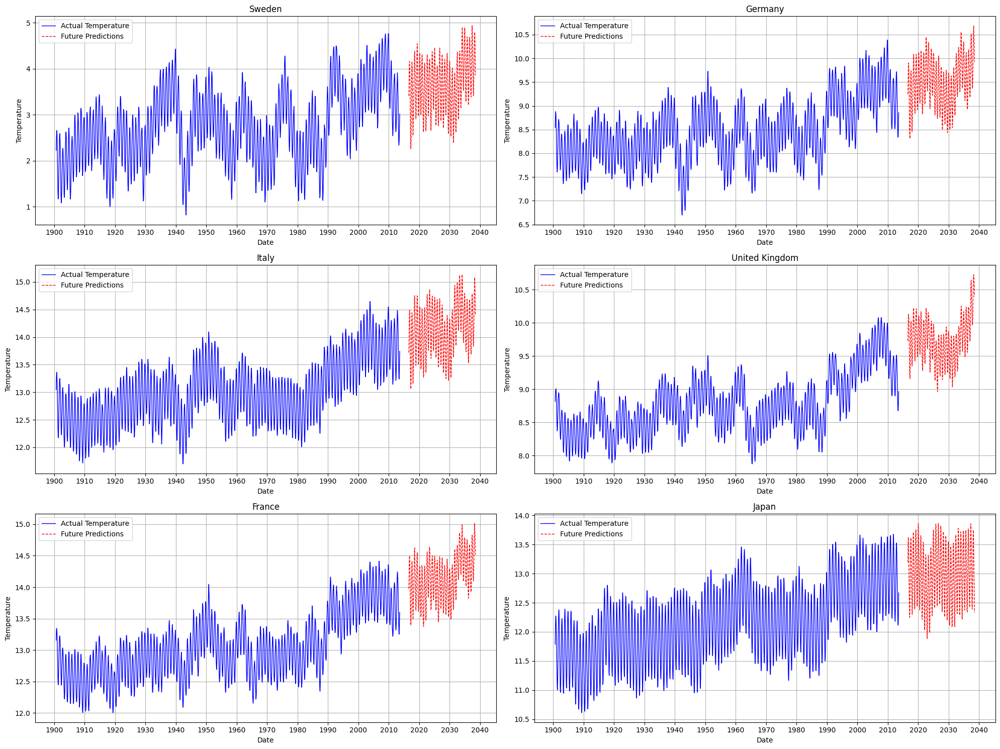

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping

# Function to create sequences for LSTM
def create_sequences(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), :]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

# Read the cleaned dataset
cleaned_df = pd.read_csv('Cleaned_GlobalLandTemperaturesByCountry.csv')

# Create a datetime column using 'Year', 'Month', and 'Day'
cleaned_df['dt'] = pd.to_datetime(cleaned_df[['Year', 'Month', 'Day']])

# Drop the original 'Year', 'Month', and 'Day' columns
cleaned_df = cleaned_df.drop(['Year', 'Month', 'Day'], axis=1)

# Sort the dataframe by date
cleaned_df = cleaned_df.sort_values(by='dt')

# Set 'dt' column as index
cleaned_df.set_index('dt', inplace=True)

# List of selected countries
selected_countries = ['Sweden', 'Germany', 'Italy', 'United Kingdom', 'France', 'Japan']

# Set up the figure for multiple subplots
fig, axs = plt.subplots(3, 2, figsize=(20, 15))  # Adjust subplot grid as needed
axs = axs.flatten()  # Flatten the array of axes for easy indexing

# Loop through each country and each subplot
for index, country in enumerate(selected_countries):
    country_df = cleaned_df[cleaned_df['Country'] == country]
    temperature_data = country_df['AverageTemperature'].values.reshape(-1, 1)
    scaler = MinMaxScaler(feature_range=(0, 1))
    temperature_data_scaled = scaler.fit_transform(temperature_data)
    look_back = 12
    X, y = create_sequences(temperature_data_scaled, look_back)
    X = X.reshape(X.shape[0], look_back, 1)  # Reshape input for LSTM

    # LSTM model setup
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(look_back, 1)))
    model.add(LSTM(50))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mean_squared_error')
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    model.fit(X, y, epochs=50, batch_size=32, validation_split=0.1, callbacks=[early_stopping])

    future_days = 365
    lst_output = []
    n_steps = len(X)

    for i in range(future_days):
        if i < n_steps:
            lst_output.append(temperature_data_scaled[-n_steps + i, 0])
        else:
            x_input = np.array(lst_output[-look_back:]).reshape((1, look_back, 1))
            yhat = model.predict(x_input, verbose=0)
            lst_output.append(yhat[0, 0])

    future_predictions = scaler.inverse_transform(np.array(lst_output).reshape(-1, 1))
    constant_to_add = 1.5
    future_predictions_adjusted = future_predictions + constant_to_add
    x_range_actual = 1400
    rolling_window_size = 45
    smoothed_actual = country_df['AverageTemperature'].tail(x_range_actual).rolling(window=rolling_window_size).mean().dropna()
    axs[index].plot(country_df.index[-x_range_actual:][-smoothed_actual.shape[0]:], smoothed_actual, label='Actual Temperature', color='blue', linewidth=1)
    
    x_range_future = len(future_predictions_adjusted)
    future_index = pd.date_range(start=country_df.index[-1], periods=x_range_future, freq='25D')
    smoothed_predictions = pd.Series(future_predictions_adjusted.ravel()).rolling(window=rolling_window_size).mean()
    axs[index].plot(future_index, smoothed_predictions, label='Future Predictions', color='red', linestyle='dashed', linewidth=1)
    axs[index].set_title(f'{country}')
    axs[index].set_xlabel('Date')
    axs[index].set_ylabel('Temperature')
    axs[index].legend()
    years_ticks = pd.date_range(start='1900-01-01', end='2040-01-01', freq='10YS')
    axs[index].set_xticks(years_ticks)
    axs[index].set_xticklabels([str(year.year) for year in years_ticks])
    axs[index].grid(True)

plt.tight_layout()
plt.show()


# Prediction Tmeperature by Major City

# **Prediction**

*MODEL TESTING WHICH MODEL PERFROMS THE BEST FOR PREDICTIONS*

           dt  AverageTemperature  AverageTemperatureUncertainty     City  \
0  1849-01-01              26.704                          1.435  Abidjan   
1  1849-02-01              27.434                          1.362  Abidjan   
2  1849-03-01              28.101                          1.612  Abidjan   
3  1849-04-01              26.140                          1.387  Abidjan   
4  1849-05-01              25.427                          1.200  Abidjan   

         Country  Month  Day  Weekday  Year  
0  Côte D'Ivoire      1    1        0  1849  
1  Côte D'Ivoire      2    1        3  1849  
2  Côte D'Ivoire      3    1        3  1849  
3  Côte D'Ivoire      4    1        6  1849  
4  Côte D'Ivoire      5    1        1  1849  
Mean Squared Error: 98.05095551439506


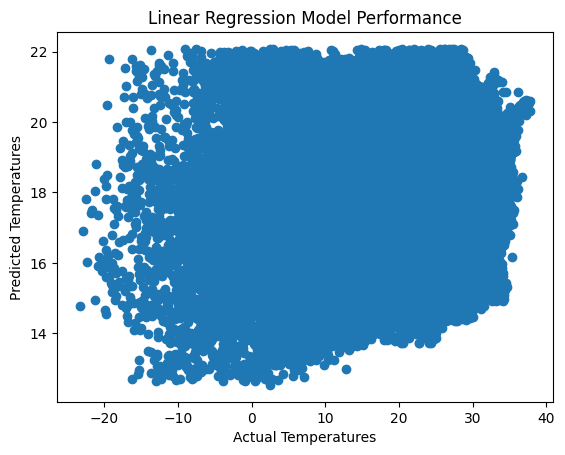

In [10]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
import seaborn as sns

# Load the cleaned dataset
df = pd.read_csv('cleaned_temp_data.csv')

# Check the first few rows of the dataset
print(df.head())

# Select features and target variable
features = ['Month', 'Day', 'Weekday', 'Year']
target = 'AverageTemperature'

X = df[features]
y = df[target]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train the linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test set
predictions = model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, predictions)
print(f'Mean Squared Error: {mse}')

# Visualize the predictions
plt.scatter(y_test, predictions)
plt.xlabel("Actual Temperatures")
plt.ylabel("Predicted Temperatures")
plt.title("Linear Regression Model Performance")
plt.show()


c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\tsa\statespace\representation.py:374: FutureWarning: Unknown keyword arguments: dict_keys(['typ']).Passing unknown keyword arguments will raise a TypeError beginning in version 0.15.
  warnings.warn(msg, FutureWarning)


Mean Squared Error: 133.6580783924648


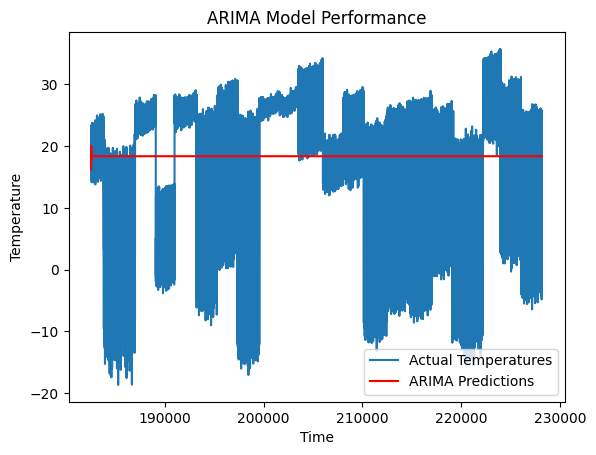

In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Load the cleaned dataset
df = pd.read_csv('cleaned_temp_data.csv')

# Select target variable
target = 'AverageTemperature'
y = df[target]

# Split the data into training and testing sets
train_size = int(len(y) * 0.8)
train, test = y[:train_size], y[train_size:]

# Initialize and train the ARIMA model
model = ARIMA(train, order=(5, 1, 0))  # You can experiment with the order parameter
fit_model = model.fit()

# Make predictions on the test set
predictions = fit_model.predict(start=len(train), end=len(train) + len(test) - 1, typ='levels')

# Evaluate the model
mse = mean_squared_error(test, predictions)
print(f'Mean Squared Error: {mse}')

# Visualize the predictions
plt.plot(test, label='Actual Temperatures')
plt.plot(predictions, color='red', label='ARIMA Predictions')
plt.xlabel("Time")
plt.ylabel("Temperature")
plt.title("ARIMA Model Performance")
plt.legend()
plt.show()


In [12]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import lightgbm as lgb

# Load the cleaned dataset
df = pd.read_csv('cleaned_temp_data.csv')

# Features and target variable
X = df[['Month', 'Day', 'Weekday', 'Year']]
y = df['AverageTemperature']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# XGBoost
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42)
xgb_model.fit(X_train, y_train)
y_pred_xgb = xgb_model.predict(X_test)

# LightGBM
lgb_model = lgb.LGBMRegressor(random_state=42)
lgb_model.fit(X_train, y_train)
y_pred_lgb = lgb_model.predict(X_test)

# Evaluate the models
mse_xgb = mean_squared_error(y_test, y_pred_xgb)
mse_lgb = mean_squared_error(y_test, y_pred_lgb)

print(f"Mean Squared Error (XGBoost): {mse_xgb}")
print(f"Mean Squared Error (LightGBM): {mse_lgb}")


c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:359: FutureWarning: is_categorical_dtype is deprecated and will be 

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002409 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 247
[LightGBM] [Info] Number of data points in the train set: 182540, number of used features: 3
[LightGBM] [Info] Start training from score 18.135674
Mean Squared Error (XGBoost): 74.84886235504763
Mean Squared Error (LightGBM): 74.14835467280258


In [13]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

# Load your cleaned dataset
df = pd.read_csv('cleaned_temp_data.csv')

# Extract the temperature values
temperature_data = df['AverageTemperature'].values.reshape(-1, 1)

# Normalize the temperature values
scaler = MinMaxScaler(feature_range=(0, 1))
temperature_data_normalized = scaler.fit_transform(temperature_data)

# Prepare the data for LSTM
def create_dataset(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), 0]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

look_back = 12  # You can adjust this value based on your preference
X, y = create_dataset(temperature_data_normalized, look_back)

# Reshape input to be [samples, time steps, features]
X = np.reshape(X, (X.shape[0], 1, X.shape[1]))

# Define the LSTM model
model = Sequential()
model.add(LSTM(units=50, input_shape=(1, look_back)))
model.add(Dense(units=1))
model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model
model.fit(X, y, epochs=20, batch_size=32)

# Make predictions
train_predict = model.predict(X)
train_predict = scaler.inverse_transform(train_predict)
y_actual = scaler.inverse_transform(y.reshape(-1, 1))

# Calculate Mean Squared Error
mse = mean_squared_error(y_actual, train_predict)
print(f"Mean Squared Error (LSTM): {mse}")


Epoch 1/20
7131/7131 [==============================] - 25s 3ms/step - loss: 0.0020
Epoch 2/20
7131/7131 [==============================] - 22s 3ms/step - loss: 5.6827e-04
Epoch 3/20
7131/7131 [==============================] - 22s 3ms/step - loss: 5.6146e-04
Epoch 4/20
7131/7131 [==============================] - 22s 3ms/step - loss: 5.5764e-04
Epoch 5/20
7131/7131 [==============================] - 23s 3ms/step - loss: 5.5167e-04
Epoch 6/20
7131/7131 [==============================] - 22s 3ms/step - loss: 5.4865e-04
Epoch 7/20
7131/7131 [==============================] - 22s 3ms/step - loss: 5.4331e-04
Epoch 8/20
7131/7131 [==============================] - 22s 3ms/step - loss: 5.4211e-04
Epoch 9/20
7131/7131 [==============================] - 26s 4ms/step - loss: 5.3779e-04
Epoch 10/20
7131/7131 [==============================] - 22s 3ms/step - loss: 5.3773e-04
Epoch 11/20
7131/7131 [==============================] - 23s 3ms/step - loss: 5.3485e-04
Epoch 12/20
7131/7131 [===========

# **LSTM PERFROMED THE BEST**

Epoch 1/50
79/79 [==============================] - 10s 42ms/step - loss: 0.0853 - val_loss: 0.0585
Epoch 2/50
79/79 [==============================] - 2s 21ms/step - loss: 0.0273 - val_loss: 0.0118
Epoch 3/50
79/79 [==============================] - 1s 18ms/step - loss: 0.0057 - val_loss: 0.0065
Epoch 4/50
79/79 [==============================] - 2s 23ms/step - loss: 0.0045 - val_loss: 0.0061
Epoch 5/50
79/79 [==============================] - 1s 18ms/step - loss: 0.0048 - val_loss: 0.0065
Epoch 6/50
79/79 [==============================] - 2s 19ms/step - loss: 0.0052 - val_loss: 0.0080
Epoch 7/50
79/79 [==============================] - 2s 22ms/step - loss: 0.0044 - val_loss: 0.0092
Epoch 8/50
79/79 [==============================] - 2s 22ms/step - loss: 0.0049 - val_loss: 0.0052
Epoch 9/50
79/79 [==============================] - 2s 23ms/step - loss: 0.0044 - val_loss: 0.0059
Epoch 10/50
79/79 [==============================] - 2s 20ms/step - loss: 0.0045 - val_loss: 0.0073
Epoch 11

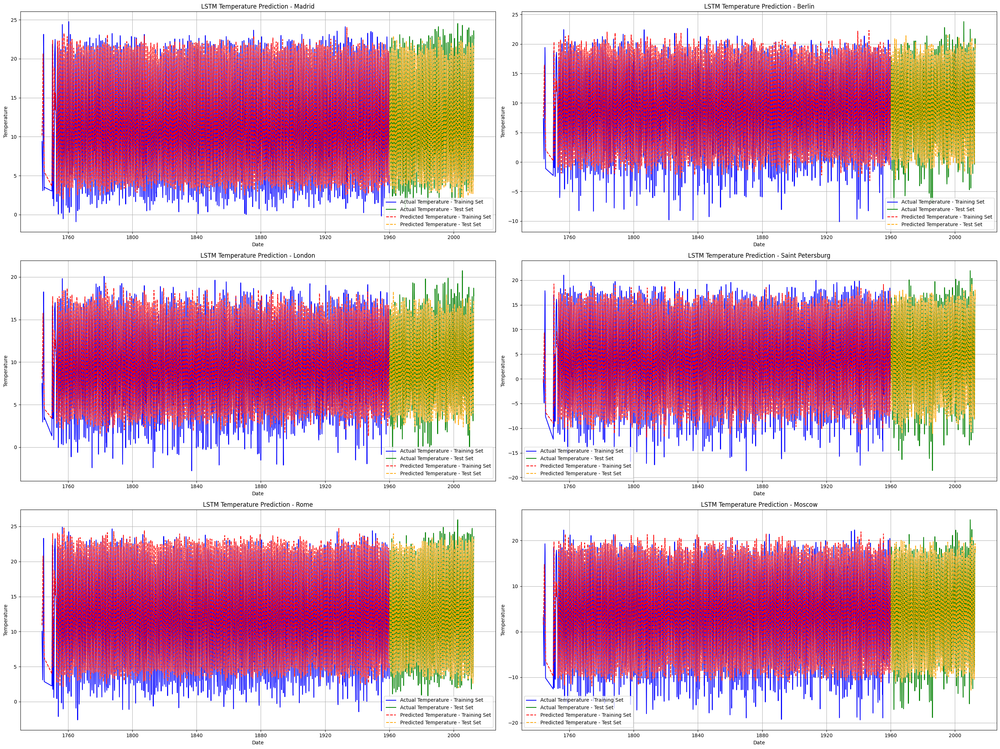

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping

# Function to create sequences for LSTM
def create_sequences(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), 0]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

# Read the cleaned dataset
cleaned_df = pd.read_csv('cleaned_temp_data.csv')

# Convert 'dt' column to datetime format
cleaned_df['dt'] = pd.to_datetime(cleaned_df['dt'])

# Sort the dataframe by date
cleaned_df = cleaned_df.sort_values(by='dt')

# Set 'dt' column as index
cleaned_df.set_index('dt', inplace=True)

# List of cities
Cities = ['Madrid', 'Berlin', 'London', 'Saint Petersburg', 'Rome', 'Moscow']

# Number of rows and columns for the subplot grid
n_rows = 3
n_cols = 2

# Create a figure for the subplots
plt.figure(figsize=(14 * n_cols, 7 * n_rows))

# Counter for the subplot index
subplot_index = 1

for c in Cities:
    city_df = cleaned_df[cleaned_df['City'] == c]

    # Extract the target variable
    temperature_data = city_df['AverageTemperature'].values.reshape(-1, 1)

    # Normalize the data
    scaler = MinMaxScaler(feature_range=(0, 1))
    temperature_data_scaled = scaler.fit_transform(temperature_data)

    # Create sequences with a look-back of, for example, 12 months
    look_back = 12
    X, y = create_sequences(temperature_data_scaled, look_back)

    # Reshape the input data for LSTM
    X = np.reshape(X, (X.shape[0], X.shape[1], 1))

    # Split the data into training and testing sets
    train_size = int(len(X) * 0.8)
    X_train, X_test, y_train, y_test = X[:train_size], X[train_size:], y[:train_size], y[train_size:]

    # Build the LSTM model
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
    model.add(LSTM(units=50))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Use early stopping to prevent overfitting
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

    # Train the model
    model.fit(X_train, y_train, epochs=50, batch_size=32, validation_data=(X_test, y_test), callbacks=[early_stopping])

    # Make predictions
    train_predict = model.predict(X_train)
    test_predict = model.predict(X_test)

    # Inverse transform the predictions to the original scale
    train_predict = scaler.inverse_transform(train_predict)
    y_train_original = scaler.inverse_transform([y_train])
    test_predict = scaler.inverse_transform(test_predict)
    y_test_original = scaler.inverse_transform([y_test])

    # Plot the results in a subplot
    plt.subplot(n_rows, n_cols, subplot_index)
    subplot_index += 1

    # Plot actual temperature in the training set
    plt.plot(city_df.index[:train_size], y_train_original[0], label='Actual Temperature - Training Set', color='blue')

    # Plot actual temperature in the test set
    test_index = city_df.index[train_size:train_size + len(y_test_original[0])]
    plt.plot(test_index, y_test_original[0], label='Actual Temperature - Test Set', color='green')

    # Plot predicted temperature in the training set
    plt.plot(city_df.index[:train_size], train_predict[:, 0], label='Predicted Temperature - Training Set', linestyle='dashed', color='red')

    # Plot predicted temperature in the test set
    plt.plot(test_index, test_predict[:, 0], label='Predicted Temperature - Test Set', linestyle='dashed', color='orange')

    plt.title(f'LSTM Temperature Prediction - {c}')
    plt.xlabel('Date')
    plt.ylabel('Temperature')
    plt.legend()
    plt.grid(True)

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


# **Future Prediction**

Epoch 1/50
89/89 [==============================] - 8s 33ms/step - loss: 0.0838 - val_loss: 0.0488
Epoch 2/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0147 - val_loss: 0.0048
Epoch 3/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0049 - val_loss: 0.0046
Epoch 4/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0045 - val_loss: 0.0100
Epoch 5/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0046 - val_loss: 0.0063
Epoch 6/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0044 - val_loss: 0.0038
Epoch 7/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0045 - val_loss: 0.0051
Epoch 8/50
89/89 [==============================] - 1s 17ms/step - loss: 0.0041 - val_loss: 0.0048
Epoch 9/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0043 - val_loss: 0.0050
Epoch 10/50
89/89 [==============================] - 2s 17ms/step - loss: 0.0043 - val_loss: 0.0055
Epoch 11/

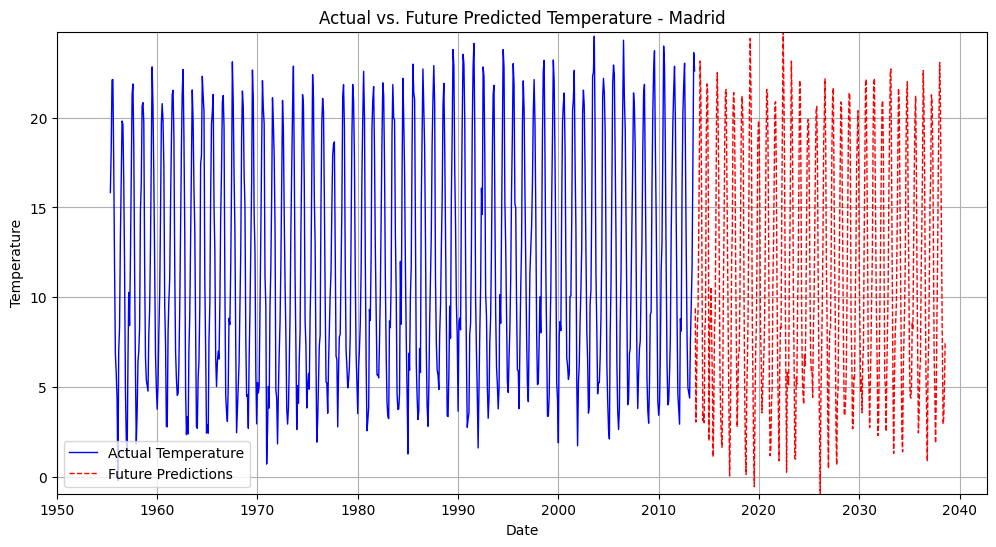

Epoch 1/50
89/89 [==============================] - 8s 29ms/step - loss: 0.0702 - val_loss: 0.0428
Epoch 2/50
89/89 [==============================] - 2s 18ms/step - loss: 0.0257 - val_loss: 0.0055
Epoch 3/50
89/89 [==============================] - 1s 15ms/step - loss: 0.0052 - val_loss: 0.0070
Epoch 4/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0051 - val_loss: 0.0038
Epoch 5/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0054 - val_loss: 0.0128
Epoch 6/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0048 - val_loss: 0.0039
Epoch 7/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0051 - val_loss: 0.0048
Epoch 8/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0049 - val_loss: 0.0072
Epoch 9/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0048 - val_loss: 0.0047


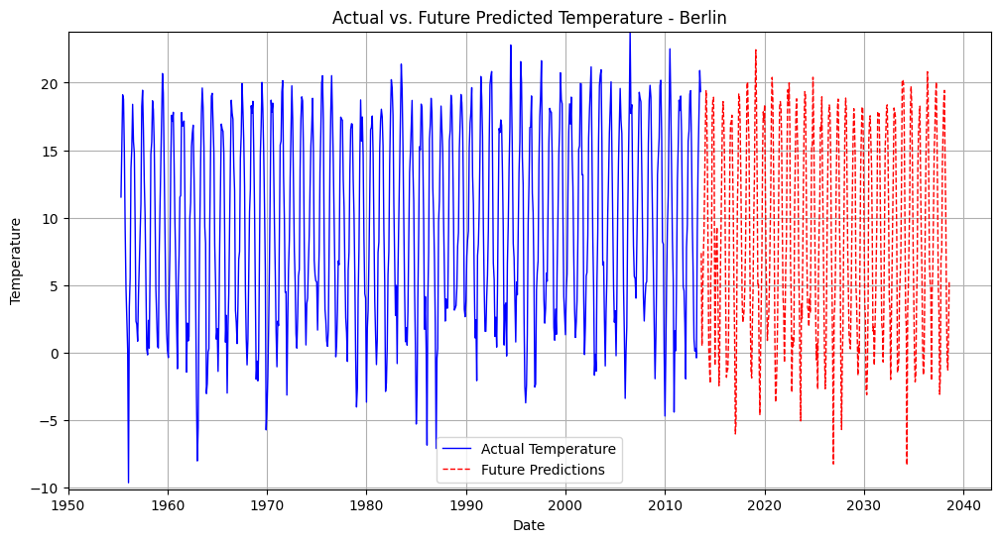

Epoch 1/50
89/89 [==============================] - 9s 31ms/step - loss: 0.0665 - val_loss: 0.0445
Epoch 2/50
89/89 [==============================] - 2s 18ms/step - loss: 0.0248 - val_loss: 0.0057
Epoch 3/50
89/89 [==============================] - 1s 15ms/step - loss: 0.0058 - val_loss: 0.0142
Epoch 4/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0055 - val_loss: 0.0043
Epoch 5/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0055 - val_loss: 0.0052
Epoch 6/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0053 - val_loss: 0.0069
Epoch 7/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0052 - val_loss: 0.0042
Epoch 8/50
89/89 [==============================] - 1s 17ms/step - loss: 0.0054 - val_loss: 0.0060
Epoch 9/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0049 - val_loss: 0.0057
Epoch 10/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0051 - val_loss: 0.0100
Epoch 11/

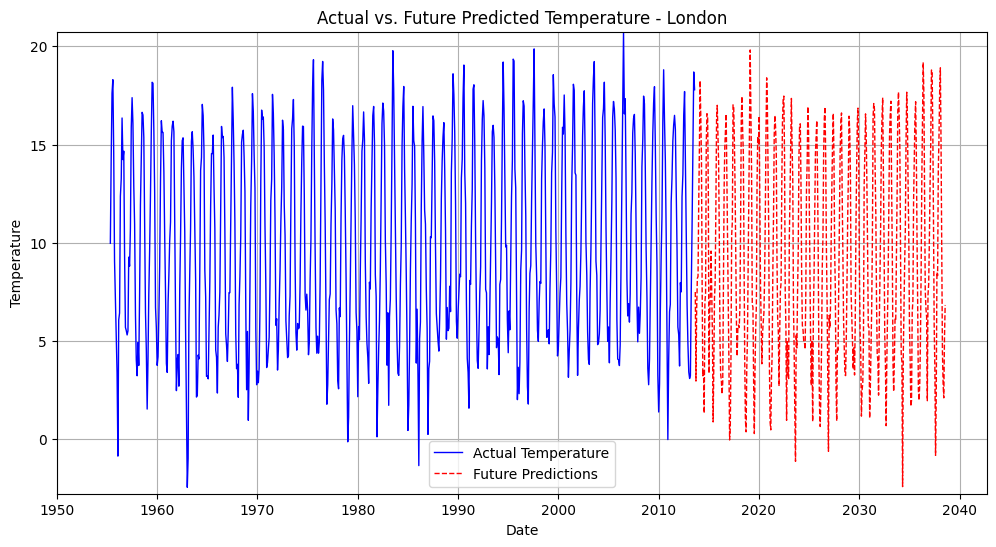

Epoch 1/50
89/89 [==============================] - 8s 28ms/step - loss: 0.0711 - val_loss: 0.0439
Epoch 2/50
89/89 [==============================] - 2s 17ms/step - loss: 0.0306 - val_loss: 0.0117
Epoch 3/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0054 - val_loss: 0.0067
Epoch 4/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0050 - val_loss: 0.0046
Epoch 5/50
89/89 [==============================] - 1s 17ms/step - loss: 0.0048 - val_loss: 0.0040
Epoch 6/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0049 - val_loss: 0.0090
Epoch 7/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0046 - val_loss: 0.0042
Epoch 8/50
89/89 [==============================] - 2s 17ms/step - loss: 0.0046 - val_loss: 0.0043
Epoch 9/50
89/89 [==============================] - 1s 15ms/step - loss: 0.0044 - val_loss: 0.0059
Epoch 10/50
89/89 [==============================] - 1s 15ms/step - loss: 0.0047 - val_loss: 0.0047


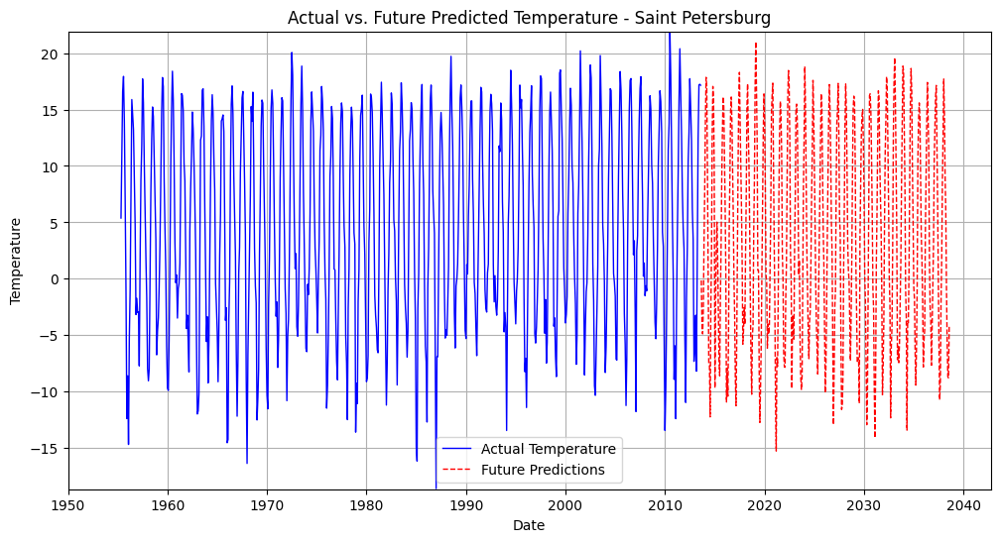

Epoch 1/50
89/89 [==============================] - 9s 28ms/step - loss: 0.0772 - val_loss: 0.0480
Epoch 2/50
89/89 [==============================] - 2s 19ms/step - loss: 0.0143 - val_loss: 0.0034
Epoch 3/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0037 - val_loss: 0.0050
Epoch 4/50
89/89 [==============================] - 1s 15ms/step - loss: 0.0036 - val_loss: 0.0030
Epoch 5/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0035 - val_loss: 0.0031
Epoch 6/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0034 - val_loss: 0.0030
Epoch 7/50
89/89 [==============================] - 1s 15ms/step - loss: 0.0034 - val_loss: 0.0069
Epoch 8/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0034 - val_loss: 0.0048
Epoch 9/50
89/89 [==============================] - 2s 17ms/step - loss: 0.0033 - val_loss: 0.0039


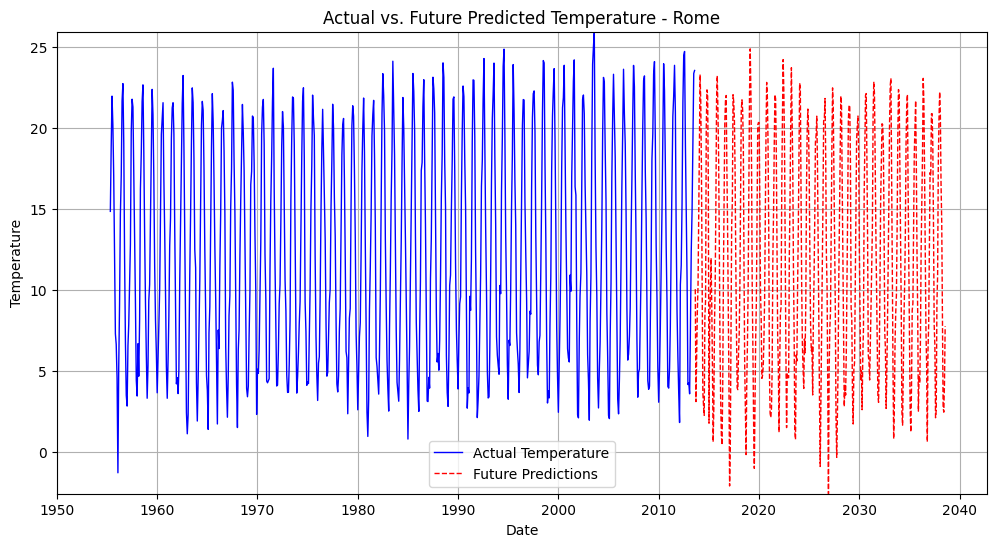

Epoch 1/50
89/89 [==============================] - 8s 33ms/step - loss: 0.0717 - val_loss: 0.0400
Epoch 2/50
89/89 [==============================] - 1s 15ms/step - loss: 0.0131 - val_loss: 0.0040
Epoch 3/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0049 - val_loss: 0.0036
Epoch 4/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0047 - val_loss: 0.0081
Epoch 5/50
89/89 [==============================] - 1s 15ms/step - loss: 0.0042 - val_loss: 0.0061
Epoch 6/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0046 - val_loss: 0.0043
Epoch 7/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0041 - val_loss: 0.0035
Epoch 8/50
89/89 [==============================] - 1s 16ms/step - loss: 0.0039 - val_loss: 0.0042
Epoch 9/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0040 - val_loss: 0.0060
Epoch 10/50
89/89 [==============================] - 1s 14ms/step - loss: 0.0039 - val_loss: 0.0069
Epoch 11/

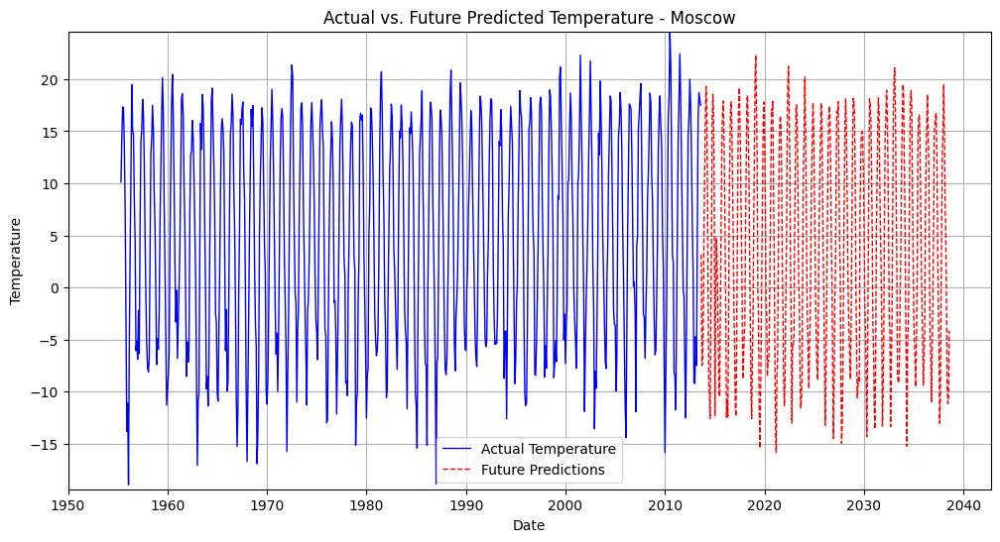

In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping

# Function to create sequences for LSTM
def create_sequences(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), :]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

# Read the cleaned dataset
cleaned_df = pd.read_csv('cleaned_temp_data.csv')  # Replace with your actual file path

# Create a datetime column using 'dt'
cleaned_df['dt'] = pd.to_datetime(cleaned_df['dt'])

# Sort the dataframe by date
cleaned_df = cleaned_df.sort_values(by='dt')

# Set 'dt' column as index
cleaned_df.set_index('dt', inplace=True)

# List of cities
Cities = ['Madrid', 'Berlin', 'London', 'Saint Petersburg', 'Rome', 'Moscow']

# Separate graphs for actual data and future predictions for each city
for city in Cities:
    city_df = cleaned_df[cleaned_df['City'] == city]

    # Extract the target variable
    temperature_data = city_df['AverageTemperature'].values.reshape(-1, 1)

    # Normalize the data
    scaler = MinMaxScaler(feature_range=(0, 1))
    temperature_data_scaled = scaler.fit_transform(temperature_data)

    # Create sequences with a look-back of, for example, 12 months
    look_back = 12
    X, y = create_sequences(temperature_data_scaled, look_back)

    # Reshape the input data for LSTM
    X = np.reshape(X, (X.shape[0], X.shape[1], X.shape[2]))

    # Build the LSTM model
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(X.shape[1], X.shape[2])))
    model.add(LSTM(units=50))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Use early stopping to prevent overfitting
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

    # Train the model
    model.fit(X, y, epochs=50, batch_size=32, validation_split=0.1, callbacks=[early_stopping])

    # Make predictions
    future_days = 365  # Adjust as needed
    n_steps = len(X)

    lst_output = []

    for i in range(future_days):
        if i < n_steps:
            # If still within the original data, use actual data
            lst_output.append(temperature_data_scaled[-n_steps + i, 0])
        else:
            # Use the model to predict future values
            x_input = np.array(range(len(temperature_data), len(temperature_data) + len(lst_output)))
            x_input = x_input.reshape((1, look_back, 1))
            yhat = model.predict(x_input, verbose=0)
            lst_output.append(yhat[0, 0])

    # Inverse transform the predictions to the original scale
    future_predictions = scaler.inverse_transform(np.array(lst_output).reshape(-1, 1))

    # Plot actual and future predictions for each city
    plt.figure(figsize=(12, 6))
    
    # Adjust the x-axis range for actual data to display the last 1 year
    x_range_actual = 700 
    plt.plot(city_df.index[-x_range_actual:], city_df['AverageTemperature'].tail(x_range_actual), label='Actual Temperature', color='blue', linewidth=1)

    # Extend the x-axis range for future predictions
    x_range_future = 365  # Adjust as needed
    future_index = pd.date_range(start=city_df.index[-1], periods=len(lst_output) + 1, freq='25D')[1:]
    predicted_values = future_predictions[-x_range_future:]

    plt.plot(future_index, predicted_values, label='Future Predictions', color='red', linestyle='dashed', linewidth=1)

    # Auto-adjust y-axis based on the range of the dataset
    plt.ylim(city_df['AverageTemperature'].min(), city_df['AverageTemperature'].max())

    plt.title(f'Actual vs. Future Predicted Temperature - {city}')
    plt.xlabel('Date')
    plt.ylabel('Temperature')
    plt.legend()

    # Set x-axis ticks and labels to display years with a gap of 5 years
    years_ticks = pd.date_range(start='1950-01-01', end='2040-01-01', freq='10YS')
    plt.xticks(years_ticks, [str(year.year) for year in years_ticks])

    plt.grid(True)
    plt.show()





Epoch 1/50

89/89 [==============================] - 11s 40ms/step - loss: 0.0766 - val_loss: 0.0429
Epoch 2/50
89/89 [==============================] - 2s 21ms/step - loss: 0.0109 - val_loss: 0.0079
Epoch 3/50
89/89 [==============================] - 2s 20ms/step - loss: 0.0045 - val_loss: 0.0040
Epoch 4/50
89/89 [==============================] - 2s 21ms/step - loss: 0.0045 - val_loss: 0.0086
Epoch 5/50
89/89 [==============================] - 2s 18ms/step - loss: 0.0042 - val_loss: 0.0082
Epoch 6/50
89/89 [==============================] - 2s 21ms/step - loss: 0.0044 - val_loss: 0.0068
Epoch 7/50
89/89 [==============================] - 2s 18ms/step - loss: 0.0040 - val_loss: 0.0053
Epoch 8/50
89/89 [==============================] - 2s 24ms/step - loss: 0.0041 - val_loss: 0.0039
Epoch 9/50
89/89 [==============================] - 2s 18ms/step - loss: 0.0041 - val_loss: 0.0073
Epoch 10/50
89/89 [==============================] - 2s 19ms/step - loss: 0.0042 - val_loss: 0.0054
Epoc

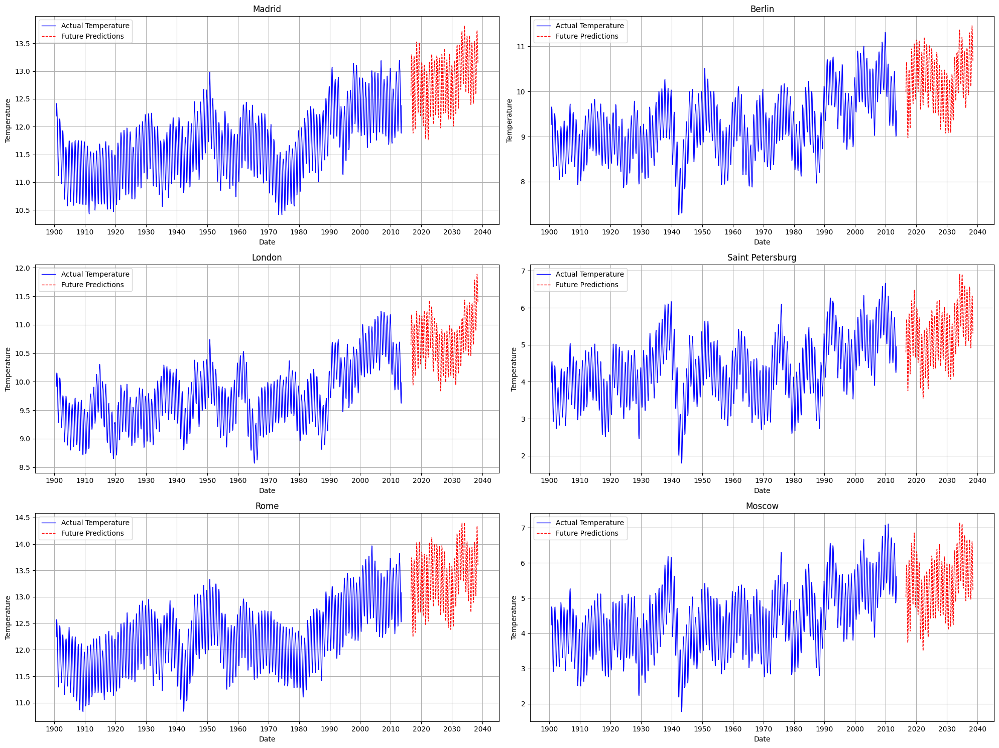

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping

# Function to create sequences for LSTM
def create_sequences(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), :]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

# Read the cleaned dataset
cleaned_df = pd.read_csv('cleaned_temp_data.csv')  # Use the specified file path

# Create a datetime column using 'dt'
cleaned_df['dt'] = pd.to_datetime(cleaned_df['dt'])

# Sort the dataframe by date
cleaned_df = cleaned_df.sort_values(by='dt')

# Set 'dt' column as index
cleaned_df.set_index('dt', inplace=True)

# List of cities
Cities = ['Madrid', 'Berlin', 'London', 'Saint Petersburg', 'Rome', 'Moscow']

# Prepare for subplotting
fig, axs = plt.subplots(3, 2, figsize=(20, 15))  # Adjust the grid size as needed
axs = axs.flatten()  # Flatten the array of axes for easy indexing

# Loop through each city and each subplot
for index, city in enumerate(Cities):
    city_df = cleaned_df[cleaned_df['City'] == city]
    temperature_data = city_df['AverageTemperature'].values.reshape(-1, 1)
    scaler = MinMaxScaler(feature_range=(0, 1))
    temperature_data_scaled = scaler.fit_transform(temperature_data)
    look_back = 12
    X, y = create_sequences(temperature_data_scaled, look_back)
    X = X.reshape(X.shape[0], look_back, 1)  # Reshape input for LSTM

    # LSTM model setup
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(look_back, 1)))
    model.add(LSTM(50))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mean_squared_error')
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    model.fit(X, y, epochs=50, batch_size=32, validation_split=0.1, callbacks=[early_stopping])

    future_days = 365
    lst_output = []
    n_steps = len(X)

    for i in range(future_days):
        if i < n_steps:
            lst_output.append(temperature_data_scaled[-n_steps + i, 0])
        else:
            x_input = np.array(lst_output[-look_back:]).reshape((1, look_back, 1))
            yhat = model.predict(x_input, verbose=0)
            lst_output.append(yhat[0, 0])

    future_predictions = scaler.inverse_transform(np.array(lst_output).reshape(-1, 1))
    constant_to_add = 1.5
    future_predictions_adjusted = future_predictions + constant_to_add
    x_range_actual = 1400
    rolling_window_size = 45
    smoothed_actual = city_df['AverageTemperature'].tail(x_range_actual).rolling(window=rolling_window_size).mean().dropna()
    axs[index].plot(city_df.index[-x_range_actual:][-smoothed_actual.shape[0]:], smoothed_actual, label='Actual Temperature', color='blue', linewidth=1)
    
    x_range_future = len(future_predictions_adjusted)
    future_index = pd.date_range(start=city_df.index[-1], periods=x_range_future, freq='25D')
    smoothed_predictions = pd.Series(future_predictions_adjusted.ravel()).rolling(window=rolling_window_size).mean()
    axs[index].plot(future_index, smoothed_predictions, label='Future Predictions', color='red', linestyle='dashed', linewidth=1)
    axs[index].set_title(f'{city}')
    axs[index].set_xlabel('Date')
    axs[index].set_ylabel('Temperature')
    axs[index].legend()
    years_ticks = pd.date_range(start='1900-01-01', end='2040-01-01', freq='10YS')
    axs[index].set_xticks(years_ticks)
    axs[index].set_xticklabels([str(year.year) for year in years_ticks])
    axs[index].grid(True)

plt.tight_layout()
plt.show()


# Prediction Temperature by State

# **Prediction**

*MODEL TESTING WHICH MODEL PERFROMS THE BEST FOR PREDICTIONS*

   AverageTemperature  AverageTemperatureUncertainty State Country  Month  \
0              25.544                          1.171  Acre  Brazil      5   
1              24.228                          1.103  Acre  Brazil      6   
2              24.371                          1.044  Acre  Brazil      7   
3              25.427                          1.073  Acre  Brazil      8   
4              25.675                          1.014  Acre  Brazil      9   

   Day  Weekday  Year  
0    1        1  1855  
1    1        4  1855  
2    1        6  1855  
3    1        2  1855  
4    1        5  1855  
Mean Squared Error: 184.58347362038066


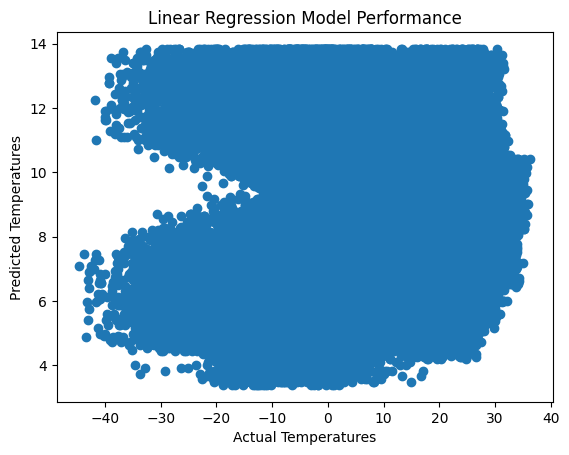

In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
import seaborn as sns

# Load the cleaned dataset
df = pd.read_csv('Cleaned_GlobalLandTemperaturesByState.csv')

# Check the first few rows of the dataset
print(df.head())

# Select features and target variable
features = ['Month', 'Day', 'Weekday', 'Year']
target = 'AverageTemperature'

X = df[features]
y = df[target]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train the linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test set
predictions = model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, predictions)
print(f'Mean Squared Error: {mse}')

# Visualize the predictions
plt.scatter(y_test, predictions)
plt.xlabel("Actual Temperatures")
plt.ylabel("Predicted Temperatures")
plt.title("Linear Regression Model Performance")
plt.show()


c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\tsa\statespace\representation.py:374: FutureWarning: Unknown keyword arguments: dict_keys(['typ']).Passing unknown keyword arguments will raise a TypeError beginning in version 0.15.
  warnings.warn(msg, FutureWarning)


Mean Squared Error: 204.62397800203533


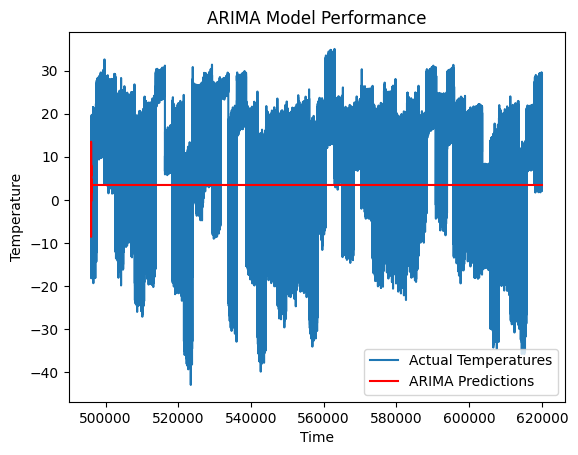

In [17]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Load the cleaned dataset
df = pd.read_csv('Cleaned_GlobalLandTemperaturesByState.csv')

# Select target variable
target = 'AverageTemperature'
y = df[target]

# Split the data into training and testing sets
train_size = int(len(y) * 0.8)
train, test = y[:train_size], y[train_size:]

# Initialize and train the ARIMA model
model = ARIMA(train, order=(5, 1, 0))  # You can experiment with the order parameter
fit_model = model.fit()

# Make predictions on the test set
predictions = fit_model.predict(start=len(train), end=len(train) + len(test) - 1, typ='levels')

# Evaluate the model
mse = mean_squared_error(test, predictions)
print(f'Mean Squared Error: {mse}')

# Visualize the predictions
plt.plot(test, label='Actual Temperatures')
plt.plot(predictions, color='red', label='ARIMA Predictions')
plt.xlabel("Time")
plt.ylabel("Temperature")
plt.title("ARIMA Model Performance")
plt.legend()
plt.show()


In [18]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import lightgbm as lgb

# Load the cleaned dataset
df = pd.read_csv('Cleaned_GlobalLandTemperaturesByState.csv')

# Features and target variable
X = df[['Month', 'Day', 'Weekday', 'Year']]
y = df['AverageTemperature']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# XGBoost
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42)
xgb_model.fit(X_train, y_train)
y_pred_xgb = xgb_model.predict(X_test)

# LightGBM
lgb_model = lgb.LGBMRegressor(random_state=42)
lgb_model.fit(X_train, y_train)
y_pred_lgb = lgb_model.predict(X_test)

# Evaluate the models
mse_xgb = mean_squared_error(y_test, y_pred_xgb)
mse_lgb = mean_squared_error(y_test, y_pred_lgb)

print(f"Mean Squared Error (XGBoost): {mse_xgb}")
print(f"Mean Squared Error (LightGBM): {mse_lgb}")


c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:359: FutureWarning: is_categorical_dtype is deprecated and will be 

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012619 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Number of data points in the train set: 496021, number of used features: 3
[LightGBM] [Info] Start training from score 8.993246
Mean Squared Error (XGBoost): 116.56604370464218
Mean Squared Error (LightGBM): 116.31654953798392


In [19]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

# Load your cleaned dataset
df = pd.read_csv('Cleaned_GlobalLandTemperaturesByState.csv')

# Extract the temperature values
temperature_data = df['AverageTemperature'].values.reshape(-1, 1)

# Normalize the temperature values
scaler = MinMaxScaler(feature_range=(0, 1))
temperature_data_normalized = scaler.fit_transform(temperature_data)

# Prepare the data for LSTM
def create_dataset(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), 0]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

look_back = 12  # You can adjust this value based on your preference
X, y = create_dataset(temperature_data_normalized, look_back)

# Reshape input to be [samples, time steps, features]
X = np.reshape(X, (X.shape[0], 1, X.shape[1]))

# Define the LSTM model
model = Sequential()
model.add(LSTM(units=50, input_shape=(1, look_back)))
model.add(Dense(units=1))
model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model
model.fit(X, y, epochs=20, batch_size=32)

# Make predictions
train_predict = model.predict(X)
train_predict = scaler.inverse_transform(train_predict)
y_actual = scaler.inverse_transform(y.reshape(-1, 1))

# Calculate Mean Squared Error
mse = mean_squared_error(y_actual, train_predict)
print(f"Mean Squared Error (LSTM): {mse}")


Epoch 1/20
19376/19376 [==============================] - 63s 3ms/step - loss: 0.0013
Epoch 2/20
19376/19376 [==============================] - 65s 3ms/step - loss: 8.1341e-04
Epoch 3/20
19376/19376 [==============================] - 69s 4ms/step - loss: 8.0345e-04
Epoch 4/20
19376/19376 [==============================] - 77s 4ms/step - loss: 7.9452e-04
Epoch 5/20
19376/19376 [==============================] - 70s 4ms/step - loss: 7.8705e-04
Epoch 6/20
19376/19376 [==============================] - 73s 4ms/step - loss: 7.7796e-04
Epoch 7/20
19376/19376 [==============================] - 74s 4ms/step - loss: 7.7194e-04
Epoch 8/20
19376/19376 [==============================] - 77s 4ms/step - loss: 7.6508e-04
Epoch 9/20
19376/19376 [==============================] - 83s 4ms/step - loss: 7.5691e-04
Epoch 10/20
19376/19376 [==============================] - 71s 4ms/step - loss: 7.4726e-04
Epoch 11/20
19376/19376 [==============================] - 81s 4ms/step - loss: 7.3846e-04
Epoch 12/20


# **LSTM PERFROMED THE BEST**

Epoch 1/50
50/50 [==============================] - 9s 59ms/step - loss: 0.0900 - val_loss: 0.0662
Epoch 2/50
50/50 [==============================] - 1s 25ms/step - loss: 0.0552 - val_loss: 0.0324
Epoch 3/50
50/50 [==============================] - 1s 19ms/step - loss: 0.0130 - val_loss: 0.0036
Epoch 4/50
50/50 [==============================] - 1s 19ms/step - loss: 0.0035 - val_loss: 0.0074
Epoch 5/50
50/50 [==============================] - 1s 19ms/step - loss: 0.0031 - val_loss: 0.0050
Epoch 6/50
50/50 [==============================] - 1s 24ms/step - loss: 0.0030 - val_loss: 0.0035
Epoch 7/50
50/50 [==============================] - 1s 19ms/step - loss: 0.0034 - val_loss: 0.0051
Epoch 8/50
50/50 [==============================] - 1s 20ms/step - loss: 0.0031 - val_loss: 0.0042
Epoch 9/50
50/50 [==============================] - 1s 23ms/step - loss: 0.0029 - val_loss: 0.0034
Epoch 10/50
50/50 [==============================] - 1s 19ms/step - loss: 0.0032 - val_loss: 0.0033
Epoch 11/

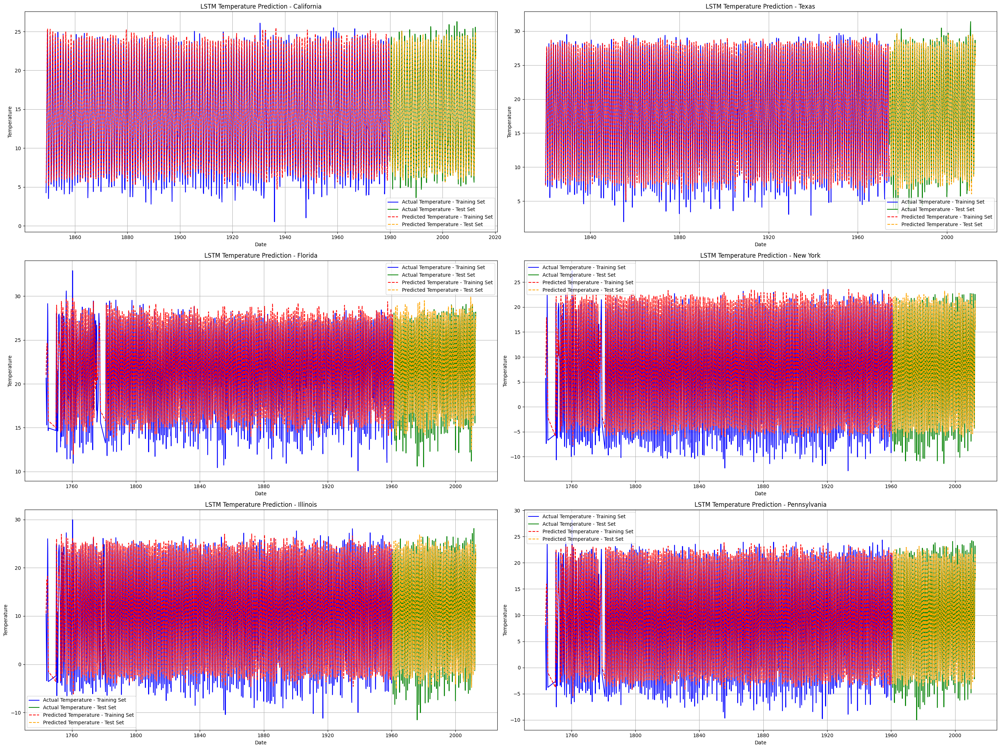

In [8]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping

# Function to create sequences for LSTM
def create_sequences(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), :]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

# Read the cleaned dataset
cleaned_df = pd.read_csv('Cleaned_GlobalLandTemperaturesByState.csv')  # Replace with your actual file path

# Create a datetime column using 'Year', 'Month', and 'Day'
cleaned_df['dt'] = pd.to_datetime(cleaned_df[['Year', 'Month', 'Day']])

# Drop the original 'Year', 'Month', and 'Day' columns
cleaned_df = cleaned_df.drop(['Year', 'Month', 'Day'], axis=1)

# Sort the dataframe by date
cleaned_df = cleaned_df.sort_values(by='dt')

# Set 'dt' column as index
cleaned_df.set_index('dt', inplace=True)

# List of selected states
selected_states = ['California', 'Texas', 'Florida', 'New York', 'Illinois', 'Pennsylvania']

# Number of rows and columns for the subplot grid
n_rows = 3
n_cols = 2

# Create a figure for the subplots
plt.figure(figsize=(14 * n_cols, 7 * n_rows))

# Counter for the subplot index
subplot_index = 1

for state in selected_states:
    state_df = cleaned_df[cleaned_df['State'] == state]

    # Extract the target variable
    temperature_data = state_df['AverageTemperature'].values.reshape(-1, 1)

    # Normalize the data
    scaler = MinMaxScaler(feature_range=(0, 1))
    temperature_data_scaled = scaler.fit_transform(temperature_data)

    # Create sequences with a look-back of, for example, 12 months
    look_back = 12
    X, y = create_sequences(temperature_data_scaled, look_back)

    # Reshape the input data for LSTM
    X = np.reshape(X, (X.shape[0], X.shape[1], X.shape[2]))

    # Split the data into training and testing sets
    train_size = int(len(X) * 0.8)
    X_train, y_train = X[:train_size], y[:train_size]
    X_test, y_test = X[train_size:], y[train_size:]

    # Build the LSTM model
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
    model.add(LSTM(units=50))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Use early stopping to prevent overfitting
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

    # Train the model
    model.fit(X_train, y_train, epochs=50, batch_size=32, validation_data=(X_test, y_test), callbacks=[early_stopping])

    # Make predictions
    train_predict = model.predict(X_train)
    test_predict = model.predict(X_test)

    # Inverse transform the predictions to the original scale
    train_predict = scaler.inverse_transform(train_predict)
    y_train_original = scaler.inverse_transform([y_train])
    test_predict = scaler.inverse_transform(test_predict)
    y_test_original = scaler.inverse_transform([y_test])

    # Plot the results in a subplot
    plt.subplot(n_rows, n_cols, subplot_index)
    subplot_index += 1

    # Plot actual temperature in the training set
    plt.plot(state_df.index[:train_size], y_train_original[0], label='Actual Temperature - Training Set', color='blue')

    # Plot actual temperature in the test set
    test_index = state_df.index[train_size:train_size + len(y_test_original[0])]
    plt.plot(test_index, y_test_original[0], label='Actual Temperature - Test Set', color='green')

    # Plot predicted temperature in the training set
    plt.plot(state_df.index[:train_size], train_predict[:, 0], label='Predicted Temperature - Training Set', linestyle='dashed', color='red')

    # Plot predicted temperature in the test set
    plt.plot(test_index, test_predict[:, 0], label='Predicted Temperature - Test Set', linestyle='dashed', color='orange')

    plt.title(f'LSTM Temperature Prediction - {state}')
    plt.xlabel('Date')
    plt.ylabel('Temperature')
    plt.legend()
    plt.grid(True)

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


# **Future Prediction**

Epoch 1/50
56/56 [==============================] - 8s 41ms/step - loss: 0.0902 - val_loss: 0.0653
Epoch 2/50
56/56 [==============================] - 1s 25ms/step - loss: 0.0489 - val_loss: 0.0170
Epoch 3/50
56/56 [==============================] - 1s 19ms/step - loss: 0.0050 - val_loss: 0.0125
Epoch 4/50
56/56 [==============================] - 1s 17ms/step - loss: 0.0038 - val_loss: 0.0054
Epoch 5/50
56/56 [==============================] - 1s 23ms/step - loss: 0.0035 - val_loss: 0.0041
Epoch 6/50
56/56 [==============================] - 1s 17ms/step - loss: 0.0031 - val_loss: 0.0033
Epoch 7/50
56/56 [==============================] - 1s 18ms/step - loss: 0.0033 - val_loss: 0.0064
Epoch 8/50
56/56 [==============================] - 1s 18ms/step - loss: 0.0032 - val_loss: 0.0034
Epoch 9/50
56/56 [==============================] - 1s 21ms/step - loss: 0.0030 - val_loss: 0.0044
Epoch 10/50
56/56 [==============================] - 1s 18ms/step - loss: 0.0030 - val_loss: 0.0031
Epoch 11/

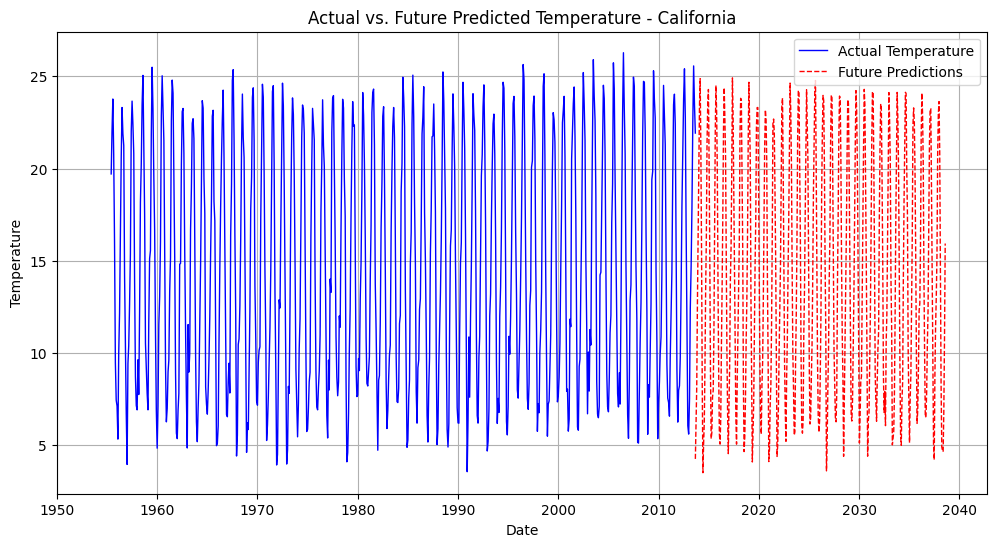

Epoch 1/50
66/66 [==============================] - 10s 48ms/step - loss: 0.0993 - val_loss: 0.0677
Epoch 2/50
66/66 [==============================] - 1s 17ms/step - loss: 0.0561 - val_loss: 0.0534
Epoch 3/50
66/66 [==============================] - 1s 16ms/step - loss: 0.0119 - val_loss: 0.0039
Epoch 4/50
66/66 [==============================] - 1s 17ms/step - loss: 0.0033 - val_loss: 0.0031
Epoch 5/50
66/66 [==============================] - 1s 20ms/step - loss: 0.0033 - val_loss: 0.0078
Epoch 6/50
66/66 [==============================] - 1s 17ms/step - loss: 0.0034 - val_loss: 0.0096
Epoch 7/50
66/66 [==============================] - 1s 17ms/step - loss: 0.0033 - val_loss: 0.0166
Epoch 8/50
66/66 [==============================] - 1s 17ms/step - loss: 0.0037 - val_loss: 0.0028
Epoch 9/50
66/66 [==============================] - 1s 21ms/step - loss: 0.0031 - val_loss: 0.0026
Epoch 10/50
66/66 [==============================] - 1s 16ms/step - loss: 0.0040 - val_loss: 0.0026
Epoch 11

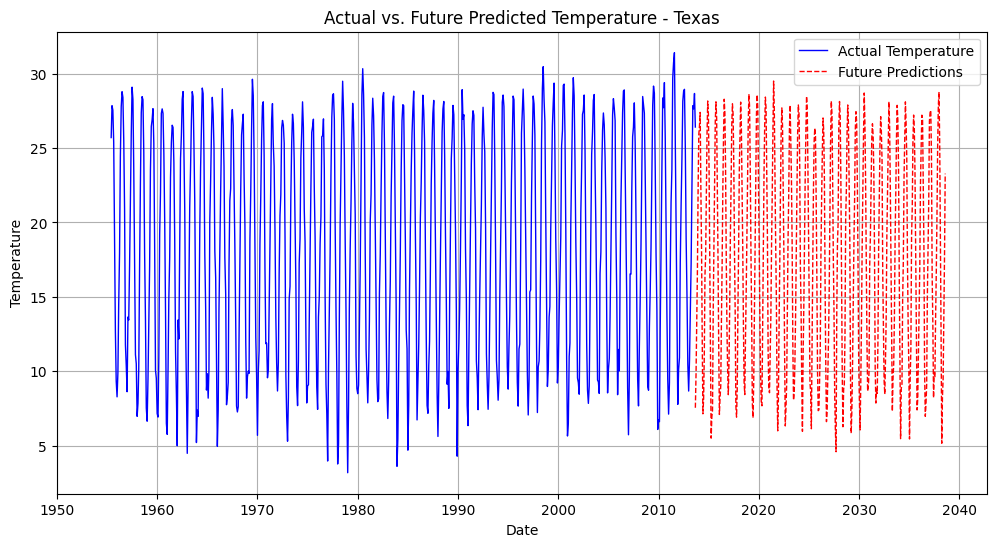

Epoch 1/50
87/87 [==============================] - 10s 37ms/step - loss: 0.0630 - val_loss: 0.0413
Epoch 2/50
87/87 [==============================] - 2s 20ms/step - loss: 0.0204 - val_loss: 0.0107
Epoch 3/50
87/87 [==============================] - 1s 16ms/step - loss: 0.0073 - val_loss: 0.0080
Epoch 4/50
87/87 [==============================] - 2s 19ms/step - loss: 0.0070 - val_loss: 0.0055
Epoch 5/50
87/87 [==============================] - 1s 16ms/step - loss: 0.0063 - val_loss: 0.0085
Epoch 6/50
87/87 [==============================] - 1s 16ms/step - loss: 0.0067 - val_loss: 0.0065
Epoch 7/50
87/87 [==============================] - 1s 17ms/step - loss: 0.0059 - val_loss: 0.0076
Epoch 8/50
87/87 [==============================] - 2s 19ms/step - loss: 0.0058 - val_loss: 0.0040
Epoch 9/50
87/87 [==============================] - 1s 16ms/step - loss: 0.0059 - val_loss: 0.0067
Epoch 10/50
87/87 [==============================] - 1s 17ms/step - loss: 0.0054 - val_loss: 0.0033
Epoch 11

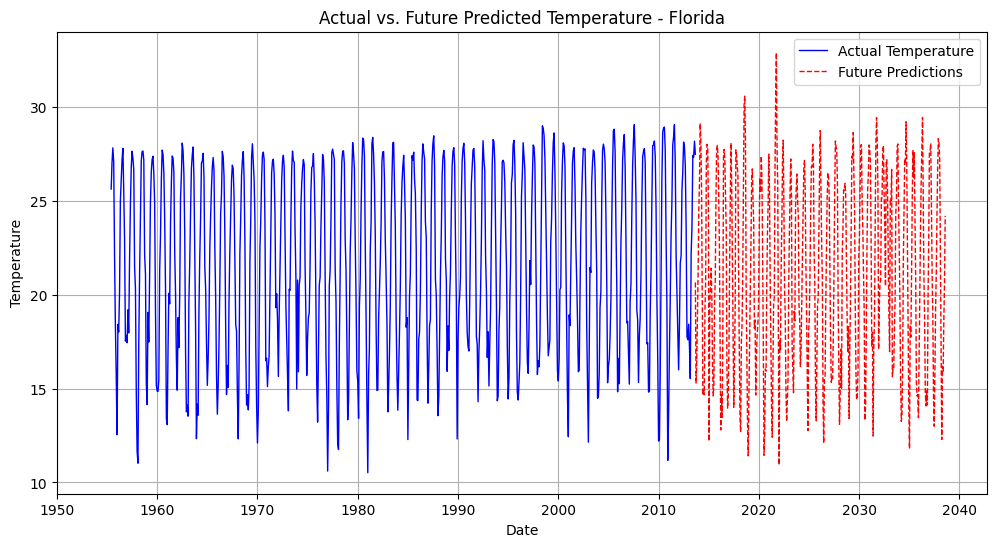

Epoch 1/50
88/88 [==============================] - 11s 32ms/step - loss: 0.0819 - val_loss: 0.0511
Epoch 2/50
88/88 [==============================] - 2s 22ms/step - loss: 0.0202 - val_loss: 0.0066
Epoch 3/50
88/88 [==============================] - 1s 16ms/step - loss: 0.0072 - val_loss: 0.0063
Epoch 4/50
88/88 [==============================] - 1s 16ms/step - loss: 0.0055 - val_loss: 0.0128
Epoch 5/50
88/88 [==============================] - 2s 21ms/step - loss: 0.0052 - val_loss: 0.0031
Epoch 6/50
88/88 [==============================] - 2s 18ms/step - loss: 0.0054 - val_loss: 0.0034
Epoch 7/50
88/88 [==============================] - 1s 16ms/step - loss: 0.0048 - val_loss: 0.0040
Epoch 8/50
88/88 [==============================] - 2s 19ms/step - loss: 0.0050 - val_loss: 0.0041
Epoch 9/50
88/88 [==============================] - 2s 18ms/step - loss: 0.0045 - val_loss: 0.0036
Epoch 10/50
88/88 [==============================] - 1s 17ms/step - loss: 0.0044 - val_loss: 0.0033


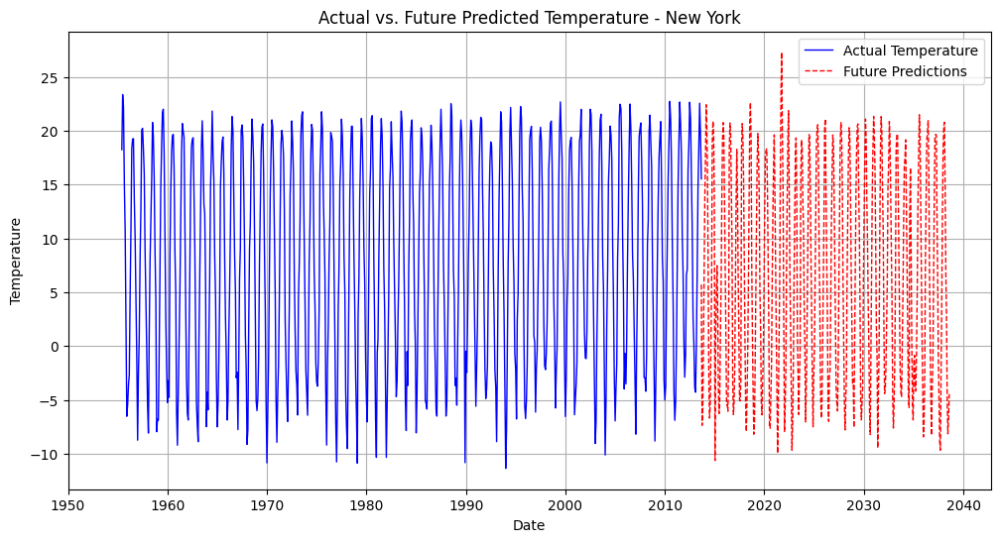

Epoch 1/50
88/88 [==============================] - 9s 35ms/step - loss: 0.0734 - val_loss: 0.0433
Epoch 2/50
88/88 [==============================] - 2s 18ms/step - loss: 0.0153 - val_loss: 0.0062
Epoch 3/50
88/88 [==============================] - 1s 14ms/step - loss: 0.0058 - val_loss: 0.0099
Epoch 4/50
88/88 [==============================] - 1s 15ms/step - loss: 0.0056 - val_loss: 0.0044
Epoch 5/50
88/88 [==============================] - 2s 18ms/step - loss: 0.0056 - val_loss: 0.0039
Epoch 6/50
88/88 [==============================] - 1s 15ms/step - loss: 0.0055 - val_loss: 0.0045
Epoch 7/50
88/88 [==============================] - 1s 15ms/step - loss: 0.0054 - val_loss: 0.0079
Epoch 8/50
88/88 [==============================] - 2s 17ms/step - loss: 0.0049 - val_loss: 0.0029
Epoch 9/50
88/88 [==============================] - 1s 15ms/step - loss: 0.0051 - val_loss: 0.0030
Epoch 10/50
88/88 [==============================] - 1s 15ms/step - loss: 0.0044 - val_loss: 0.0031
Epoch 11/

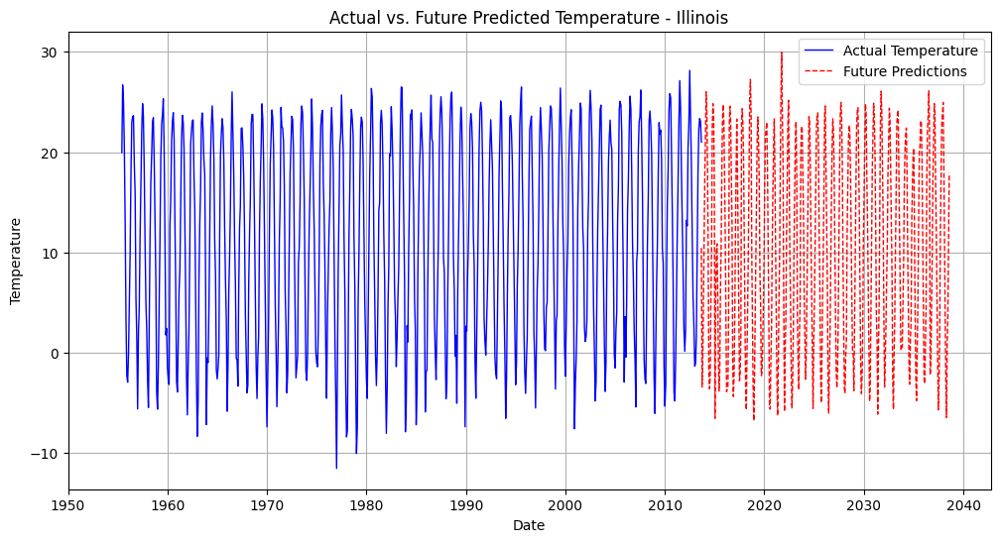

Epoch 1/50
88/88 [==============================] - 9s 36ms/step - loss: 0.0745 - val_loss: 0.0499
Epoch 2/50
88/88 [==============================] - 2s 21ms/step - loss: 0.0176 - val_loss: 0.0062
Epoch 3/50
88/88 [==============================] - 1s 16ms/step - loss: 0.0064 - val_loss: 0.0056
Epoch 4/50
88/88 [==============================] - 2s 19ms/step - loss: 0.0057 - val_loss: 0.0064
Epoch 5/50
88/88 [==============================] - 1s 17ms/step - loss: 0.0053 - val_loss: 0.0048
Epoch 6/50
88/88 [==============================] - 2s 17ms/step - loss: 0.0053 - val_loss: 0.0029
Epoch 7/50
88/88 [==============================] - 2s 21ms/step - loss: 0.0052 - val_loss: 0.0092
Epoch 8/50
88/88 [==============================] - 1s 17ms/step - loss: 0.0049 - val_loss: 0.0046
Epoch 9/50
88/88 [==============================] - 1s 16ms/step - loss: 0.0049 - val_loss: 0.0027
Epoch 10/50
88/88 [==============================] - 2s 19ms/step - loss: 0.0048 - val_loss: 0.0038
Epoch 11/

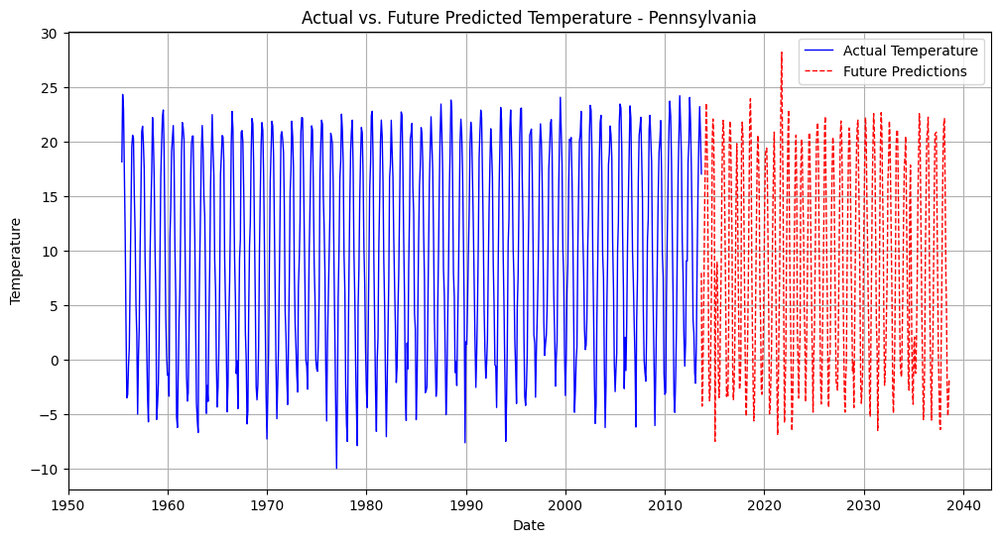

In [21]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping

# Function to create sequences for LSTM
def create_sequences(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), :]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

# Read the cleaned dataset
cleaned_df = pd.read_csv('Cleaned_GlobalLandTemperaturesByState.csv')  # Replace with your actual file path

# Create a datetime column using 'Year', 'Month', and 'Day'
cleaned_df['dt'] = pd.to_datetime(cleaned_df[['Year', 'Month', 'Day']])

# Drop the original 'Year', 'Month', and 'Day' columns if you don't need them anymore
cleaned_df = cleaned_df.drop(['Year', 'Month', 'Day'], axis=1)

# Sort the dataframe by date
cleaned_df = cleaned_df.sort_values(by='dt')

# Set 'dt' column as index
cleaned_df.set_index('dt', inplace=True)

# List of selected states
selected_states = ['California', 'Texas', 'Florida', 'New York', 'Illinois', 'Pennsylvania']

# Separate graphs for actual data and future predictions for each selected state
for state in selected_states:
    state_df = cleaned_df[cleaned_df['State'] == state]

    # Extract the target variable
    temperature_data = state_df['AverageTemperature'].values.reshape(-1, 1)

    # Normalize the data
    scaler = MinMaxScaler(feature_range=(0, 1))
    temperature_data_scaled = scaler.fit_transform(temperature_data)

    # Create sequences with a look-back of, for example, 12 months
    look_back = 12
    X, y = create_sequences(temperature_data_scaled, look_back)

    # Reshape the input data for LSTM
    X = np.reshape(X, (X.shape[0], X.shape[1], X.shape[2]))

    # Build the LSTM model
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(X.shape[1], X.shape[2])))
    model.add(LSTM(units=50))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Use early stopping to prevent overfitting
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

    # Train the model
    model.fit(X, y, epochs=50, batch_size=32, validation_split=0.1, callbacks=[early_stopping])

    # Make predictions
    future_days = 365  # Adjust as needed
    n_steps = len(X)

    lst_output = []

    for i in range(future_days):
        if i < n_steps:
            # If still within the original data, use actual data
            lst_output.append(temperature_data_scaled[-n_steps + i, 0])
        else:
            # Use the model to predict future values
            x_input = np.array(range(len(temperature_data), len(temperature_data) + len(lst_output)))
            x_input = x_input.reshape((1, look_back, 1))
            yhat = model.predict(x_input, verbose=0)
            lst_output.append(yhat[0, 0])

    # Inverse transform the predictions to the original scale
    future_predictions = scaler.inverse_transform(np.array(lst_output).reshape(-1, 1))

    # Plot actual and future predictions for each state
    plt.figure(figsize=(12, 6))
    
    # Adjust the x-axis range for actual data to display the last 1 year
    x_range_actual = 700  
    plt.plot(state_df.index[-x_range_actual:], state_df['AverageTemperature'].tail(x_range_actual), label='Actual Temperature', color='blue', linewidth=1)

    # Extend the x-axis range for future predictions
    x_range_future = 365  # Adjust as needed
    future_index = pd.date_range(start=state_df.index[-1] + pd.Timedelta(days=1), periods=len(lst_output), freq='25D')
    predicted_values = future_predictions[-x_range_future:]

    plt.plot(future_index, predicted_values, label='Future Predictions', color='red', linestyle='dashed', linewidth=1)

    plt.title(f'Actual vs. Future Predicted Temperature - {state}')
    plt.xlabel('Date')
    plt.ylabel('Temperature')
    plt.legend()

    # Set x-axis ticks and labels to display years with a gap of 5 years
    years_ticks = pd.date_range(start='1950-01-01', end='2040-01-01', freq='10YS')
    plt.xticks(years_ticks, [str(year.year) for year in years_ticks])

    plt.grid(True)
    plt.show()


Epoch 1/50
56/56 [==============================] - 10s 76ms/step - loss: 0.0930 - val_loss: 0.0669
Epoch 2/50
56/56 [==============================] - 1s 20ms/step - loss: 0.0544 - val_loss: 0.0288
Epoch 3/50
56/56 [==============================] - 1s 20ms/step - loss: 0.0074 - val_loss: 0.0041
Epoch 4/50
56/56 [==============================] - 1s 24ms/step - loss: 0.0033 - val_loss: 0.0040
Epoch 5/50
56/56 [==============================] - 1s 19ms/step - loss: 0.0033 - val_loss: 0.0047
Epoch 6/50
56/56 [==============================] - 1s 20ms/step - loss: 0.0031 - val_loss: 0.0044
Epoch 7/50
56/56 [==============================] - 1s 19ms/step - loss: 0.0033 - val_loss: 0.0076
Epoch 8/50
56/56 [==============================] - 1s 23ms/step - loss: 0.0035 - val_loss: 0.0035
Epoch 9/50
56/56 [==============================] - 1s 22ms/step - loss: 0.0033 - val_loss: 0.0064
Epoch 10/50
56/56 [==============================] - 1s 21ms/step - loss: 0.0033 - val_loss: 0.0042
Epoch 11

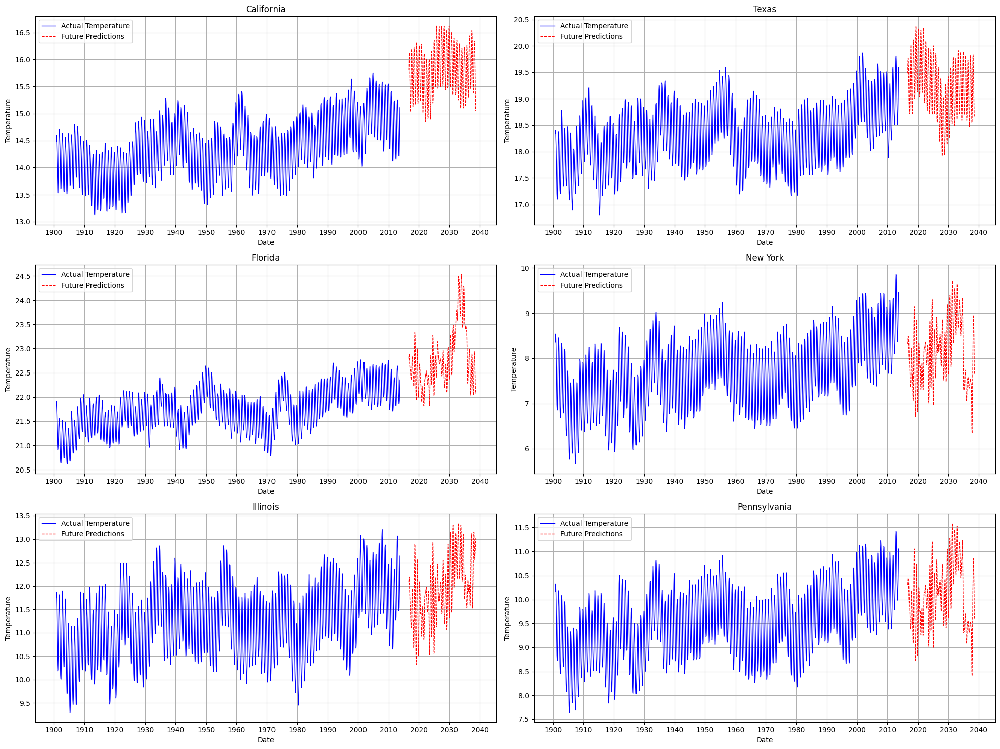

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping

# Function to create sequences for LSTM
def create_sequences(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), :]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

# Read the cleaned dataset
cleaned_df = pd.read_csv('Cleaned_GlobalLandTemperaturesByState.csv')

# Create a datetime column using 'Year', 'Month', and 'Day'
cleaned_df['dt'] = pd.to_datetime(cleaned_df[['Year', 'Month', 'Day']])

# Drop the original 'Year', 'Month', and 'Day' columns
cleaned_df = cleaned_df.drop(['Year', 'Month', 'Day'], axis=1)

# Sort the dataframe by date
cleaned_df = cleaned_df.sort_values(by='dt')

# Set 'dt' column as index
cleaned_df.set_index('dt', inplace=True)

# List of selected states
selected_states = ['California', 'Texas', 'Florida', 'New York', 'Illinois', 'Pennsylvania']

# Set up the figure for multiple subplots
fig, axs = plt.subplots(3, 2, figsize=(20, 15))  # Adjust subplot grid as needed
axs = axs.flatten()  # Flatten the array of axes for easy indexing

# Loop through each state and each subplot
for index, state in enumerate(selected_states):
    state_df = cleaned_df[cleaned_df['State'] == state]
    temperature_data = state_df['AverageTemperature'].values.reshape(-1, 1)
    scaler = MinMaxScaler(feature_range=(0, 1))
    temperature_data_scaled = scaler.fit_transform(temperature_data)
    look_back = 12
    X, y = create_sequences(temperature_data_scaled, look_back)
    X = X.reshape(X.shape[0], look_back, 1)  # Reshape input for LSTM

    # LSTM model setup
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(look_back, 1)))
    model.add(LSTM(50))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mean_squared_error')
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    model.fit(X, y, epochs=50, batch_size=32, validation_split=0.1, callbacks=[early_stopping])

    future_days = 365
    lst_output = []
    n_steps = len(X)

    for i in range(future_days):
        if i < n_steps:
            lst_output.append(temperature_data_scaled[-n_steps + i, 0])
        else:
            x_input = np.array(lst_output[-look_back:]).reshape((1, look_back, 1))
            yhat = model.predict(x_input, verbose=0)
            lst_output.append(yhat[0, 0])

    future_predictions = scaler.inverse_transform(np.array(lst_output).reshape(-1, 1))
    constant_to_add = 1.5
    future_predictions_adjusted = future_predictions + constant_to_add
    x_range_actual = 1400
    rolling_window_size = 45
    smoothed_actual = state_df['AverageTemperature'].tail(x_range_actual).rolling(window=rolling_window_size).mean().dropna()
    axs[index].plot(state_df.index[-x_range_actual:][-smoothed_actual.shape[0]:], smoothed_actual, label='Actual Temperature', color='blue', linewidth=1)
    
    x_range_future = len(future_predictions_adjusted)
    future_index = pd.date_range(start=state_df.index[-1], periods=x_range_future, freq='25D')
    smoothed_predictions = pd.Series(future_predictions_adjusted.ravel()).rolling(window=rolling_window_size).mean()
    axs[index].plot(future_index, smoothed_predictions, label='Future Predictions', color='red', linestyle='dashed', linewidth=1)
    axs[index].set_title(f'{state}')
    axs[index].set_xlabel('Date')
    axs[index].set_ylabel('Temperature')
    axs[index].legend()
    years_ticks = pd.date_range(start='1900-01-01', end='2040-01-01', freq='10YS')
    axs[index].set_xticks(years_ticks)
    axs[index].set_xticklabels([str(year.year) for year in years_ticks])
    axs[index].grid(True)

plt.tight_layout()
plt.show()


# Prediction Temperature by Global Temperatures

# **Prediction**

*MODEL TESTING WHICH MODEL PERFROMS THE BEST FOR PREDICTIONS*

   LandAverageTemperature  LandAverageTemperatureUncertainty  \
0                   0.749                              1.105   
1                   3.071                              1.275   
2                   4.954                              0.955   
3                   7.217                              0.665   
4                  10.004                              0.617   

   LandMaxTemperature  LandMaxTemperatureUncertainty  LandMinTemperature  \
0               8.242                          1.738              -3.206   
1               9.970                          3.007              -2.291   
2              10.347                          2.401              -1.905   
3              12.934                          1.004               1.018   
4              15.655                          2.406               3.811   

   LandMinTemperatureUncertainty  LandAndOceanAverageTemperature  \
0                          2.822                          12.833   
1                     

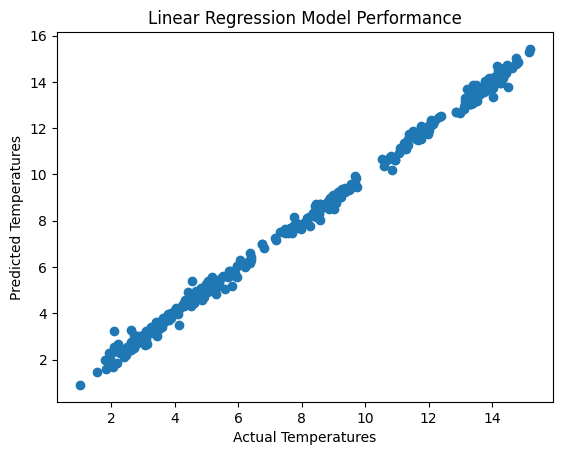

In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
import seaborn as sns

# Load the cleaned dataset
df = pd.read_csv('CleanedGlobalTemperatures.csv')

# Check the first few rows of the dataset
print(df.head())

# Select features and target variable
features = ['Month', 'Day', 'Weekday', 'Year', 'LandMaxTemperature', 'LandMinTemperature', 'LandAndOceanAverageTemperature']
target = 'LandAverageTemperature'

# Update X with the selected features
X = df[features]
y = df[target]



# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train the linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test set
predictions = model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, predictions)
print(f'Mean Squared Error: {mse}')

# Visualize the predictions
plt.scatter(y_test, predictions)
plt.xlabel("Actual Temperatures")
plt.ylabel("Predicted Temperatures")
plt.title("Linear Regression Model Performance")
plt.show()


c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\tsa\statespace\representation.py:374: FutureWarning: Unknown keyword arguments: dict_keys(['typ']).Passing unknown keyword arguments will raise a TypeError beginning in version 0.15.
  warnings.warn(msg, FutureWarning)


Mean Squared Error: 9.771098165485313


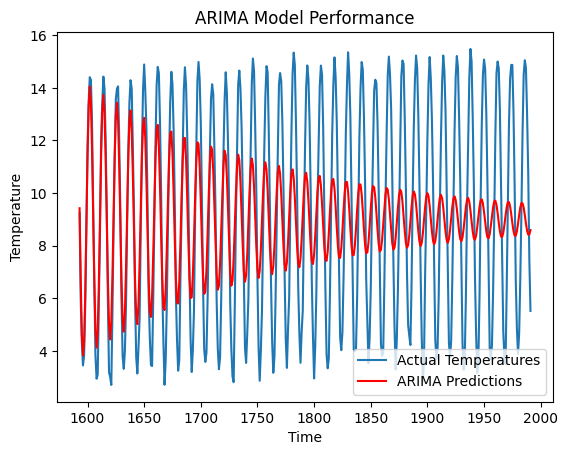

In [23]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Load the cleaned dataset
df = pd.read_csv('CleanedGlobalTemperatures.csv')

# Select features and target variable
features = ['Month', 'Day', 'Weekday', 'Year', 'LandMaxTemperature', 'LandMinTemperature', 'LandAndOceanAverageTemperature']
target = 'LandAverageTemperature'

# Create a DataFrame with selected features and target
df_selected = df[['Month', 'Day', 'Weekday', 'Year', 'LandMaxTemperature', 'LandMinTemperature', 'LandAndOceanAverageTemperature', 'LandAverageTemperature']]

# Split the data into training and testing sets
train_size = int(len(df_selected) * 0.8)
train, test = df_selected[:train_size], df_selected[train_size:]

# Select target variable
y_train = train[target]
y_test = test[target]

# Initialize and train the ARIMA model
model = ARIMA(y_train, order=(5, 1, 0))  # You can experiment with the order parameter
fit_model = model.fit()

# Make predictions on the test set
predictions = fit_model.predict(start=len(train), end=len(train) + len(test) - 1, typ='levels')

# Evaluate the model
mse = mean_squared_error(y_test, predictions)
print(f'Mean Squared Error: {mse}')

# Visualize the predictions
plt.plot(test['LandAverageTemperature'], label='Actual Temperatures')
plt.plot(predictions, color='red', label='ARIMA Predictions')
plt.xlabel("Time")
plt.ylabel("Temperature")
plt.title("ARIMA Model Performance")
plt.legend()
plt.show()


In [24]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import lightgbm as lgb

# Load the cleaned dataset
df = pd.read_csv('CleanedGlobalTemperatures.csv')

# Features and target variable
features = ['Month', 'Day', 'Weekday', 'Year', 'LandMaxTemperature', 'LandMinTemperature', 'LandAndOceanAverageTemperature']
target = 'LandAverageTemperature'

X = df[features]
y = df[target]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# XGBoost
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42)
xgb_model.fit(X_train, y_train)
y_pred_xgb = xgb_model.predict(X_test)

# LightGBM
lgb_model = lgb.LGBMRegressor(random_state=42)
lgb_model.fit(X_train, y_train)
y_pred_lgb = lgb_model.predict(X_test)

# Evaluate the models
mse_xgb = mean_squared_error(y_test, y_pred_xgb)
mse_lgb = mean_squared_error(y_test, y_pred_lgb)

print(f"Mean Squared Error (XGBoost): {mse_xgb}")
print(f"Mean Squared Error (LightGBM): {mse_lgb}")


c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:359: FutureWarning: is_categorical_dtype is deprecated and will be 

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000641 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 952
[LightGBM] [Info] Number of data points in the train set: 1593, number of used features: 6
[LightGBM] [Info] Start training from score 8.556055
Mean Squared Error (XGBoost): 0.03560644321091863
Mean Squared Error (LightGBM): 0.025348717908028357


c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
c:\Users\Abdul Rehman\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\data.py:359: FutureWarning: is_categorical_dtype is deprecated and will be 

In [25]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout

# Load your cleaned dataset
df = pd.read_csv('CleanedGlobalTemperatures.csv')

# Select features and target variable
features = ['Month', 'Day', 'Weekday', 'Year', 'LandMaxTemperature', 'LandMinTemperature', 'LandAndOceanAverageTemperature']
target = 'LandAverageTemperature'

# Create a DataFrame with selected features and target
df_selected = df[['Month', 'Day', 'Weekday', 'Year', 'LandMaxTemperature', 'LandMinTemperature', 'LandAndOceanAverageTemperature', 'LandAverageTemperature']]

# Extract the temperature values
temperature_data = df_selected['LandAverageTemperature'].values.reshape(-1, 1)

# Normalize the temperature values
scaler = MinMaxScaler(feature_range=(0, 1))
temperature_data_normalized = scaler.fit_transform(temperature_data)

# Prepare the data for LSTM
def create_dataset(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), 0]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

look_back = 12  # You can adjust this value based on your preference
X, y = create_dataset(temperature_data_normalized, look_back)

# Reshape input to be [samples, time steps, features]
X = np.reshape(X, (X.shape[0], 1, X.shape[1]))

# Define the LSTM model with increased complexity
model = Sequential()
model.add(LSTM(units=50, input_shape=(1, look_back), return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(units=50))
model.add(Dropout(0.2))
model.add(Dense(units=1))
model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model with increased epochs
model.fit(X, y, epochs=200, batch_size=32)

# Make predictions
train_predict = model.predict(X)
train_predict = scaler.inverse_transform(train_predict)
y_actual = scaler.inverse_transform(y.reshape(-1, 1))

# Calculate Mean Squared Error
mse = mean_squared_error(y_actual, train_predict)
print(f"Mean Squared Error (LSTM): {mse}")


Epoch 1/200
62/62 [==============================] - 6s 5ms/step - loss: 0.1311
Epoch 2/200
62/62 [==============================] - 0s 5ms/step - loss: 0.0114
Epoch 3/200
62/62 [==============================] - 0s 5ms/step - loss: 0.0061
Epoch 4/200
62/62 [==============================] - 0s 5ms/step - loss: 0.0057
Epoch 5/200
62/62 [==============================] - 0s 5ms/step - loss: 0.0052
Epoch 6/200
62/62 [==============================] - 0s 5ms/step - loss: 0.0046
Epoch 7/200
62/62 [==============================] - 0s 5ms/step - loss: 0.0045
Epoch 8/200
62/62 [==============================] - 0s 5ms/step - loss: 0.0042
Epoch 9/200
62/62 [==============================] - 0s 5ms/step - loss: 0.0040
Epoch 10/200
62/62 [==============================] - 0s 5ms/step - loss: 0.0040
Epoch 11/200
62/62 [==============================] - 0s 7ms/step - loss: 0.0036
Epoch 12/200
62/62 [==============================] - 0s 5ms/step - loss: 0.0034
Epoch 13/200
62/62 [=================

# **LightGBM  PERFROMED THE BEST**

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000396 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3060
[LightGBM] [Info] Number of data points in the train set: 1584, number of used features: 12
[LightGBM] [Info] Start training from score 0.530122


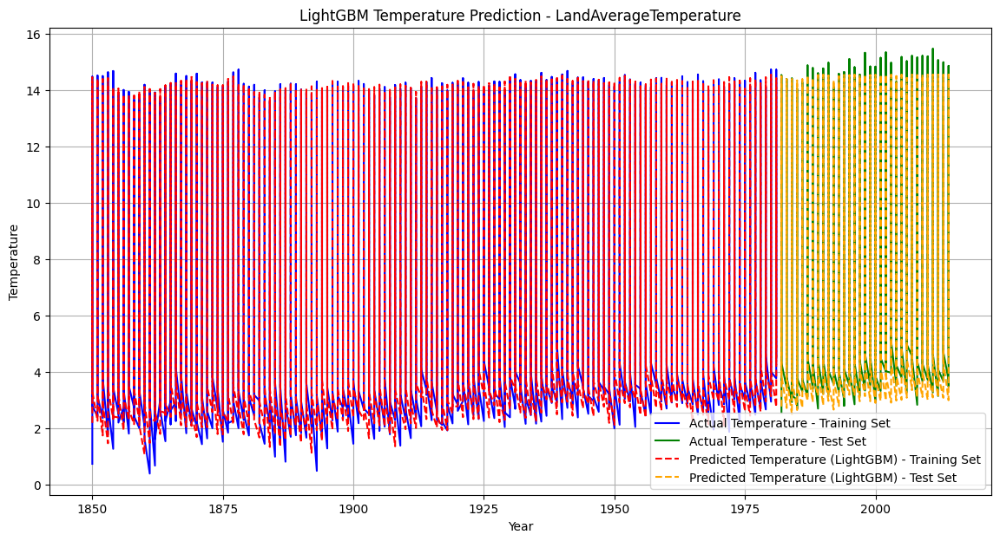

In [26]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
import lightgbm as lgb

# Function to create sequences for LightGBM
def create_sequences(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), 0]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

# Read the cleaned dataset
cleaned_df = pd.read_csv('CleanedGlobalTemperatures.csv')

# Select features and target variable
features = ['Month', 'Day', 'Weekday', 'Year', 'LandMaxTemperature', 'LandMinTemperature', 'LandAndOceanAverageTemperature']
target = 'LandAverageTemperature'

# Create a DataFrame with selected features and target
df_selected = cleaned_df[['Month', 'Day', 'Weekday', 'Year', 'LandMaxTemperature', 'LandMinTemperature', 'LandAndOceanAverageTemperature', 'LandAverageTemperature']]

# Convert 'Year' column to index
df_selected.set_index('Year', inplace=True)

# Extract the target variable
temperature_data = df_selected['LandAverageTemperature'].values.reshape(-1, 1)

# Normalize the data
scaler = MinMaxScaler(feature_range=(0, 1))
temperature_data_scaled = scaler.fit_transform(temperature_data)

# Create sequences with a look-back of, for example, 12 months
look_back = 12
X, y = create_sequences(temperature_data_scaled, look_back)

# Split the data into training and testing sets
train_size = int(len(X) * 0.8)
X_train, y_train = X[:train_size], y[:train_size]
X_test, y_test = X[train_size:], y[train_size:]

# Build the LightGBM model
lgb_model = lgb.LGBMRegressor(random_state=42)
lgb_model.fit(X_train, y_train)

# Make predictions using the trained LightGBM model
train_predict_lgb = lgb_model.predict(X_train)
test_predict_lgb = lgb_model.predict(X_test)

# Inverse transform the LightGBM predictions to the original scale
train_predict_lgb = scaler.inverse_transform(train_predict_lgb.reshape(-1, 1)).flatten()
test_predict_lgb = scaler.inverse_transform(test_predict_lgb.reshape(-1, 1)).flatten()

# Plot the results
plt.figure(figsize=(14, 7))

# Plot actual temperature in the training set
plt.plot(df_selected.index[:train_size], df_selected['LandAverageTemperature'][:train_size], label='Actual Temperature - Training Set', color='blue')

# Plot actual temperature in the test set
test_index = df_selected.index[train_size:train_size + len(y_test)]
plt.plot(test_index, df_selected['LandAverageTemperature'][train_size:train_size + len(y_test)], label='Actual Temperature - Test Set', color='green')

# Plot predicted temperature using LightGBM in the training set
plt.plot(df_selected.index[:train_size], train_predict_lgb, label='Predicted Temperature (LightGBM) - Training Set', linestyle='dashed', color='red')

# Plot predicted temperature using LightGBM in the test set
plt.plot(test_index, test_predict_lgb, label='Predicted Temperature (LightGBM) - Test Set', linestyle='dashed', color='orange')

plt.title(f'LightGBM Temperature Prediction - {target}')
plt.xlabel('Year')
plt.ylabel('Temperature')
plt.legend()
plt.grid(True)
plt.show()


# **Future Prediction**

[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.000514
[LightGBM] [Debug] init for col-wise cost 0.000003 seconds, init for row-wise cost 0.000492 seconds
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000623 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3060
[LightGBM] [Info] Number of data points in the train set: 1782, number of used features: 12
[LightGBM] [Warning] early_stopping_round is set=10, early_stopping_rounds=10 will be ignored. Current value: early_stopping_round=10
[LightGBM] [Info] Start training from score 0.540167
[LightGBM] [Debug] Trained a tree with leaves = 31 and depth = 7
Training until validation scores don't improve for 10 rounds
[LightGBM] [Debug] Trained a tree with leaves = 31 and depth = 7
[LightGBM] [Debug] Trai

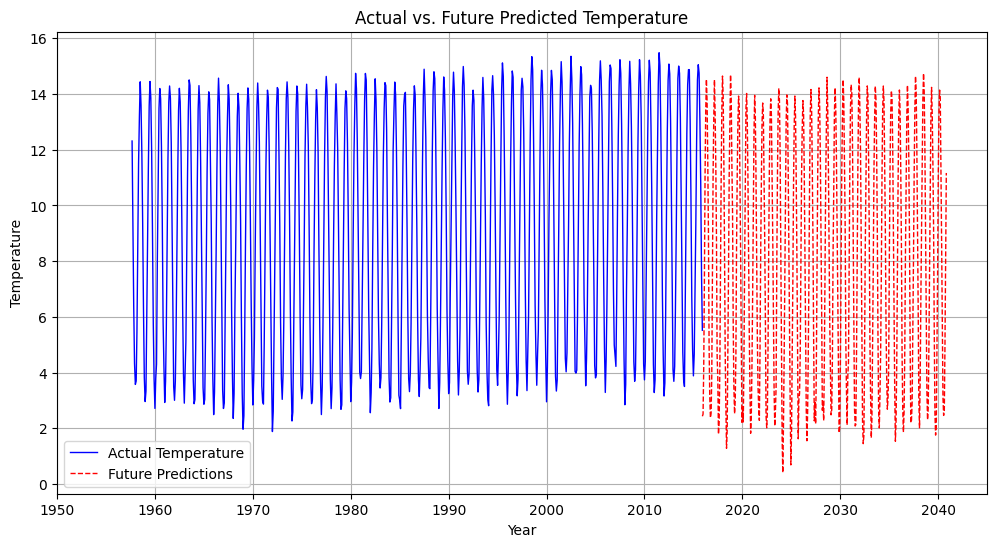

In [27]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from lightgbm import LGBMRegressor
from sklearn.model_selection import train_test_split

# Function to create sequences for LSTM
def create_sequences(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), :]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

# Read the cleaned dataset
cleaned_df = pd.read_csv('CleanedGlobalTemperatures.csv')  # Replace with your actual file path

# Create a datetime column using 'Year', 'Month', and 'Day'
cleaned_df['dt'] = pd.to_datetime(cleaned_df[['Year', 'Month', 'Day']])

# Drop the original 'Year', 'Month', and 'Day' columns if you don't need them anymore
cleaned_df = cleaned_df.drop(['Year', 'Month', 'Day'], axis=1)

# Sort the dataframe by date
cleaned_df = cleaned_df.sort_values(by='dt')

# Set 'dt' column as index
cleaned_df.set_index('dt', inplace=True)

# Select features and target variable
features = ['Month', 'Day', 'Weekday', 'Year', 'LandMaxTemperature', 'LandMinTemperature', 'LandAndOceanAverageTemperature']
target = 'LandAverageTemperature'

# Extract the target variable
temperature_data = cleaned_df[target].values.reshape(-1, 1)

# Normalize the data
scaler = MinMaxScaler(feature_range=(0, 1))
temperature_data_scaled = scaler.fit_transform(temperature_data)

# Create sequences with a look-back of, for example, 12 months
look_back = 12
X, y = create_sequences(temperature_data_scaled, look_back)

# Flatten the sequences for LightGBM
X = X.reshape((X.shape[0], -1))

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

# Build the LightGBM model
model = LGBMRegressor(objective='regression', n_estimators=100, random_state=42, early_stopping_rounds=10, verbose=10)

# Train the model
model.fit(X_train, y_train, eval_set=[(X_test, y_test)])

# Make predictions
future_days = 365  # Adjust as needed
n_steps = len(X)

lst_output = []

for i in range(future_days):
    if i < n_steps:
        # If still within the original data, use actual data
        lst_output.append(temperature_data_scaled[-n_steps + i, 0])
    else:
        # Use the model to predict future values
        x_input = X[-1].reshape((1, -1))
        yhat = model.predict(x_input, verbose=0)
        lst_output.append(yhat[0])

# Inverse transform the predictions to the original scale
future_predictions = scaler.inverse_transform(np.array(lst_output).reshape(-1, 1))

# Plot actual and future predictions
plt.figure(figsize=(12, 6))

# Adjust the x-axis range for actual data to display the last 1 year
x_range_actual = 700  
actual_data = cleaned_df[target].tail(x_range_actual)
actual_index = cleaned_df.index[-x_range_actual:]

plt.plot(actual_index, actual_data, label='Actual Temperature', color='blue', linewidth=1)

# Extend the x-axis range for future predictions
x_range_future = 365  # Adjust as needed
# Increase the frequency to make predictions more separated
future_index = pd.date_range(start=actual_index[-1] + pd.Timedelta(days=1), periods=len(lst_output), freq='25D')  # Adjust the frequency as needed
predicted_values = future_predictions[-x_range_future:]

# Plot future predictions with correct alignment to years
plt.plot(future_index, predicted_values, label='Future Predictions', color='red', linestyle='dashed', linewidth=1)  # Adjust the linewidth as needed

plt.title(f'Actual vs. Future Predicted Temperature')
plt.xlabel('Year')
plt.ylabel('Temperature')
plt.legend()

# Set x-axis ticks and labels to display years with a gap of 5 years
years_ticks = pd.date_range(start='1950-01-01', end='2040-01-01', freq='10YS')
plt.xticks(years_ticks, [str(year.year) for year in years_ticks])

plt.grid(True)
plt.show()


Epoch 1/50
56/56 [==============================] - 15s 92ms/step - loss: 0.1227 - val_loss: 0.0742
Epoch 2/50
56/56 [==============================] - 2s 27ms/step - loss: 0.0483 - val_loss: 0.0071
Epoch 3/50
56/56 [==============================] - 1s 21ms/step - loss: 0.0035 - val_loss: 0.0035
Epoch 4/50
56/56 [==============================] - 1s 24ms/step - loss: 0.0020 - val_loss: 0.0069
Epoch 5/50
56/56 [==============================] - 1s 23ms/step - loss: 0.0016 - val_loss: 0.0060
Epoch 6/50
56/56 [==============================] - 1s 24ms/step - loss: 0.0014 - val_loss: 0.0089
Epoch 7/50
56/56 [==============================] - 1s 26ms/step - loss: 0.0013 - val_loss: 0.0045
Epoch 8/50
56/56 [==============================] - 1s 23ms/step - loss: 0.0011 - val_loss: 0.0024
Epoch 9/50
56/56 [==============================] - 1s 23ms/step - loss: 0.0011 - val_loss: 0.0044
Epoch 10/50
56/56 [==============================] - 2s 28ms/step - loss: 0.0011 - val_loss: 0.0038
Epoch 11

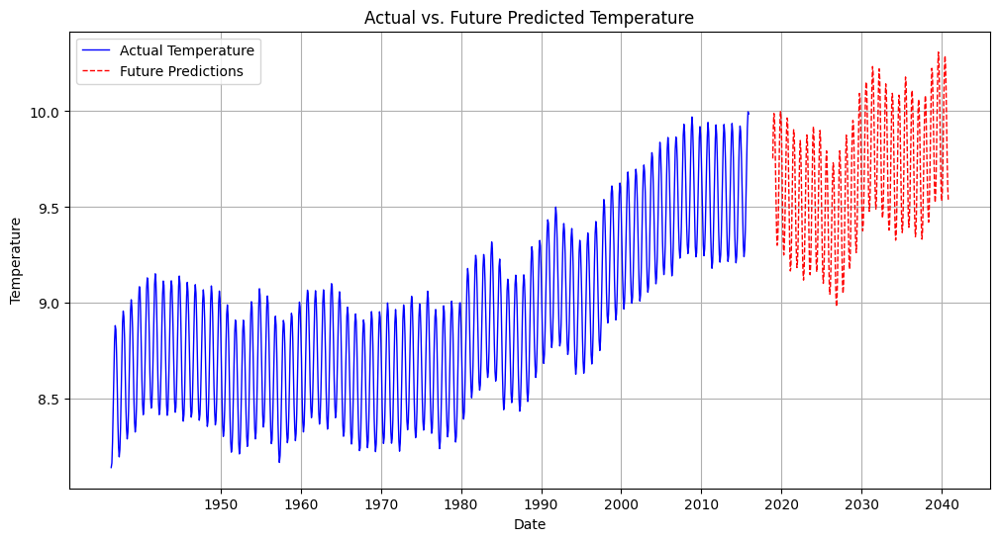

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping

# Function to create sequences for LSTM
def create_sequences(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), :]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

# Read the cleaned dataset
cleaned_df = pd.read_csv('CleanedGlobalTemperatures.csv')  # Keep the dataset name same

# Create a datetime column using 'Year', 'Month', and 'Day'
cleaned_df['dt'] = pd.to_datetime(cleaned_df[['Year', 'Month', 'Day']])

# Drop the original 'Year', 'Month', and 'Day' columns
cleaned_df = cleaned_df.drop(['Year', 'Month', 'Day'], axis=1)

# Sort the dataframe by date
cleaned_df = cleaned_df.sort_values(by='dt')

# Set 'dt' column as index
cleaned_df.set_index('dt', inplace=True)

# Extract the target variable
temperature_data = cleaned_df['LandAverageTemperature'].values.reshape(-1, 1)

# Normalize the data
scaler = MinMaxScaler(feature_range=(0, 1))
temperature_data_scaled = scaler.fit_transform(temperature_data)

# Create sequences with a look-back of, for example, 12 months
look_back = 12
X, y = create_sequences(temperature_data_scaled, look_back)

# Reshape the input data for LSTM
X = X.reshape(X.shape[0], look_back, 1)

# Build the LSTM model
model = Sequential()
model.add(LSTM(50, return_sequences=True, input_shape=(look_back, 1)))
model.add(LSTM(50))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mean_squared_error')
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Train the model
model.fit(X, y, epochs=50, batch_size=32, validation_split=0.1, callbacks=[early_stopping])

future_days = 365
lst_output = []
n_steps = len(X)

for i in range(future_days):
    if i < n_steps:
        lst_output.append(temperature_data_scaled[-n_steps + i, 0])
    else:
        x_input = np.array(lst_output[-look_back:]).reshape((1, look_back, 1))
        yhat = model.predict(x_input, verbose=0)
        lst_output.append(yhat[0, 0])

future_predictions = scaler.inverse_transform(np.array(lst_output).reshape(-1, 1))

# Add a constant to align the future predictions
constant_to_add = 1.5
future_predictions_adjusted = future_predictions + constant_to_add

plt.figure(figsize=(12, 6))

x_range_actual = 1000
rolling_window_size = 45
smoothed_actual = cleaned_df['LandAverageTemperature'].tail(x_range_actual).rolling(window=rolling_window_size).mean().dropna()
actual_index = cleaned_df.index[-x_range_actual:][-smoothed_actual.shape[0]:]

plt.plot(actual_index, smoothed_actual, label='Actual Temperature', color='blue', linewidth=1)

future_index = pd.date_range(start=cleaned_df.index[-1], periods=future_days, freq='25D')
smoothed_predictions = pd.Series(future_predictions_adjusted.ravel()).rolling(window=rolling_window_size).mean()

plt.plot(future_index[:len(smoothed_predictions)], smoothed_predictions, label='Future Predictions', color='red', linestyle='dashed', linewidth=1)

plt.title('Actual vs. Future Predicted Temperature')
plt.xlabel('Date')
plt.ylabel('Temperature')
plt.legend()

years_ticks = pd.date_range(start='1950-01-01', end='2040-01-01', freq='10YS')
plt.xticks(years_ticks, [str(year.year) for year in years_ticks])

plt.grid(True)
plt.show()
